<a href="https://colab.research.google.com/github/hvkchaitanya7/grp3capstone-final/blob/main/code/transformers/ImageCaptiongenerator_Transformer_Resnet50_No_MHA_Flickr30.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# New Section

To download Flickr Data set and unzip it . It has 8000 images and we will be using 5000 for training , 1000 validation and 2000 for testing 

In [12]:
import os
os.chdir('/content/drive/MyDrive/Project_Data/Flickr30k')

In [13]:
!pwd

/content/drive/MyDrive/Project_Data/Flickr30k


In [14]:
!ls

Flickr30_comments
Flickr30_images
Flickr30k_images.zip
Flickr30_npy
image_caption_flickr30_transformer20_resnet50_nomha.h5
image_caption_flickr30_transformer20_resnet50_nomha.pkl
image_caption_flickr30_transformer30_resnet50_nomha.h5
image_caption_flickr30_transformer30_resnet50_nomha.pkl
image_caption_tokenizer.pkl


In [ ]:
#!!7z x "/content/drive/MyDrive/Project_Data/Flickr30k/Images.zip"


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.30GHz (306F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/drive/MyDrive/Project_Data/Flickr30k/                                                        1 file, 4375126936 bytes (4173 MiB)

Extracting archive: /content/drive/MyDrive/Project_Data/Flickr30k/Images.zip
  0% 256 Open               1% 512 Open               2% 768 Open               3% 1024 Open                4% 1280 Open                4% 1536 Open                5% 1792 Open                6% 2048 Open              

                                   51% 16835 - Images/3743157427.jpg                                   51% 16836 - Images/3743169025.jpg                                   51% 16837 - Images/3743976841.jpg                                   51% 16838 - Images/3744182161.jpg                                   51% 16839 - Images/374437796.jpg                                  51% 16840 - Images/374437808.jpg                                  51% 16841 - Images/374437845.jpg                        

In [1]:
!rm -rf /content/Flickr30_numpy

In [2]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1*.npy "/content/Flickr30_numpy"
print("completed 1")

completed 1


In [3]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2*.npy "/content/Flickr30_numpy"
print("completed 2")

completed 2


In [4]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3*.npy "/content/Flickr30_numpy"
print("completed 3")

completed 3


In [5]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4*.npy "/content/Flickr30_numpy"
print("completed 4")

completed 4


In [6]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5*.npy "/content/Flickr30_numpy"
print("completed 5")

completed 5


In [7]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6*.npy "/content/Flickr30_numpy"
print("completed 6")

completed 6


In [8]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7*.npy "/content/Flickr30_numpy"
print("completed 7")

completed 7


In [9]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/8*.npy "/content/Flickr30_numpy"
print("completed 8")

completed 8


In [10]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/9*.npy "/content/Flickr30_numpy"
print("completed 9")

completed 9


In [ ]:
#!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/9*.npy "/content/Flickr30_numpy"

In [15]:
npys = os.listdir("/content/Flickr30_numpy")
print("npys count:", len(npys))

npys count: 31783


In [ ]:
#Importing all libraries for Keras , Tensorflow and Resnet50

In [16]:
import string
import numpy as np
import pandas as pd 
from numpy import array
from PIL import Image
import pickle

import matplotlib.pyplot as plt
import keras
import sys, time, os, warnings 
warnings.filterwarnings("ignore")
import re

import tensorflow as tf
from tqdm import tqdm

from nltk.translate.bleu_score import sentence_bleu

from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from keras.layers.merge import add
from keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.text import Tokenizer
from tensorflow.keras.applications.resnet50 import ResNet50
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [17]:
import fnmatch
image_path = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images"
dir_Flickr_text = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_comments/captions.txt"

#jpgs = os.listdir(image_path)
#jpgs = fnmatch.filter(os.listdir(image_path),'*.jpg')
#npys = fnmatch.filter(os.listdir(image_path),'*.npy')
#print("Total Images in Dataset = {}".format(len(jpgs)))
#print("Total npy in Dataset = {}".format(len(npys)))

In [ ]:
#check Image file name to Caption combination derived from the Flick8 dataset

In [18]:
file = open(dir_Flickr_text,'r')
text = file.read()
file.close()

datatxt = []
for line in text.split('\n'):
    col = line.split('|')
    if len(col) == 1:
        continue
    #w = col[0].split("#")
    datatxt.append(col)

data = pd.DataFrame(datatxt,columns=["filename","index","caption"])
data = data.reindex(columns =['index','filename','caption'])
data = data[data['filename'] != '2258277193_586949ec62.jpg.1']


uni_filenames = np.unique(data.filename.values)
data.head()

,index,filename,caption
0,0,1000092795.jpg,Two young guys with shaggy hair look at their ...
1,1,1000092795.jpg,"Two young , White males are outside near many ..."
2,2,1000092795.jpg,Two men in green shirts are standing in a yard .
3,3,1000092795.jpg,A man in a blue shirt standing in a garden .
4,4,1000092795.jpg,Two friends enjoy time spent together .


Print some images along with captions to check the Flickr Data that was imported

In [19]:
data.size

476745

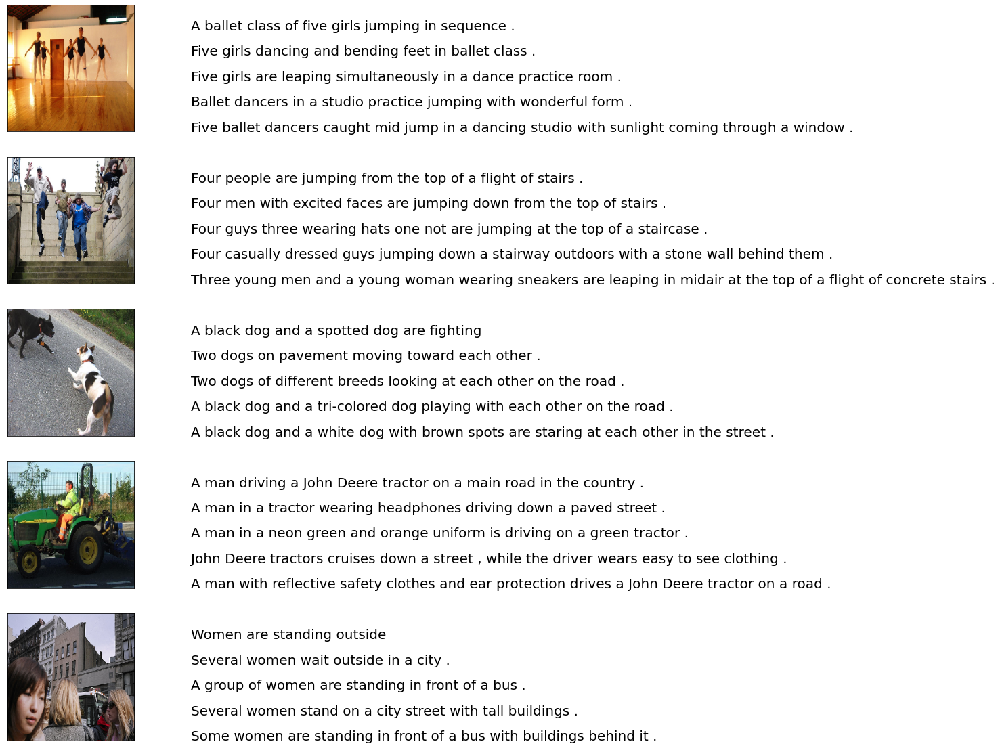

In [20]:
from keras.preprocessing.image import load_img, img_to_array

npic = 5
npix = 224
target_size = (npix,npix,3)

count = 1
fig = plt.figure(figsize=(10,20))
for jpgfnm in uni_filenames[10:15]:
    filename = image_path + '/' + jpgfnm
    captions = list(data["caption"].loc[data["filename"]==jpgfnm].values)
    image_load = load_img(filename, target_size=target_size)
    
    ax = fig.add_subplot(npic,2,count,xticks=[],yticks=[])
    ax.imshow(image_load)
    count += 1
    
    ax = fig.add_subplot(npic,2,count)
    plt.axis('off')
    ax.plot()
    ax.set_xlim(0,1)
    ax.set_ylim(0,len(captions))
    for i, caption in enumerate(captions):
        ax.text(0,i,caption,fontsize=20)
    count += 1
plt.show()

In [ ]:
# Get all the words available i the captions by splitting the sentences

In [21]:
vocabulary = []
for txt in data.caption.values:
    vocabulary.extend(txt.split())
print('Vocabulary Size: %d' % len(set(vocabulary)))

Vocabulary Size: 23538


In [ ]:
# crearting a list of Image file names and captions

In [22]:
img = data["filename"].tolist()
caption = data["caption"].tolist()

In [23]:
print(f"len(img) : {len(img)}")
print(f"len(caption) : {len(caption)}")

len(img) : 158915
len(caption) : 158915


In [24]:
""" Removing punctuations , Single characters , Numeric values from the word/Vocabulary , having them would make increase the probability of such words over others due to repetitive usage
giving undesired results """
# To remove punctuations
def remove_punctuation(text_original):
    text_no_punctuation = text_original.translate(string.punctuation)
    return(text_no_punctuation)

# To remove single characters
def remove_single_character(text):
    text_len_more_than1 = ""
    for word in text.split():
        if len(word) > 1:
            text_len_more_than1 += " " + word
    return(text_len_more_than1)

# To remove numeric values
def remove_numeric(text):
    text_no_numeric = ""
    for word in text.split():
        isalpha = word.isalpha()
        if isalpha:
            text_no_numeric += " " + word
    return(text_no_numeric)

In [ ]:
""" Cleaning up the original text without punctuations, single characters and numeric values """

' Cleaning up the original text without punctuations, single characters and numeric values '

In [25]:
def text_clean(text_original):
    text = remove_punctuation(text_original)
    text = remove_single_character(text)
    text = remove_numeric(text)
    return(text)
    
for i, caption in enumerate(data.caption.values):
    newcaption = text_clean(caption)
    data["caption"].iloc[i] = newcaption

In [27]:
#building clean vocabulary
clean_vocabulary = []
for txt in data.caption.values:
    clean_vocabulary.extend(txt.split())
print('Clean Vocabulary Size: %d' % len(set(clean_vocabulary)))

Clean Vocabulary Size: 20924


In [28]:
# adding <start> and <end> tags to sentences to identify the start and end of the sentences while looping through words in sentence
#PATH = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/"
PATH = "/content/Flickr30_numpy/"
all_captions = []

for caption  in data["caption"].astype(str):
    caption = '<start> ' + caption+ ' <end>'
    all_captions.append(caption)
all_captions[:10]

['<start>  Two young guys with shaggy hair look at their hands while hanging out in the yard <end>',
 '<start>  Two young White males are outside near many bushes <end>',
 '<start>  Two men in green shirts are standing in yard <end>',
 '<start>  man in blue shirt standing in garden <end>',
 '<start>  Two friends enjoy time spent together <end>',
 '<start>  Several men in hard hats are operating giant pulley system <end>',
 '<start>  Workers look down from up above on piece of equipment <end>',
 '<start>  Two men working on machine wearing hard hats <end>',
 '<start>  Four men on top of tall structure <end>',
 '<start>  Three men on large rig <end>']

In [29]:
#building path to read each image from the content downloaded
all_img_name_vector = []

for annot in data["filename"]:
    full_image_path = PATH + annot

    all_img_name_vector.append(full_image_path)
all_img_name_vector[:10]

['/content/Flickr30_numpy/1000092795.jpg',
 '/content/Flickr30_numpy/1000092795.jpg',
 '/content/Flickr30_numpy/1000092795.jpg',
 '/content/Flickr30_numpy/1000092795.jpg',
 '/content/Flickr30_numpy/1000092795.jpg',
 '/content/Flickr30_numpy/10002456.jpg',
 '/content/Flickr30_numpy/10002456.jpg',
 '/content/Flickr30_numpy/10002456.jpg',
 '/content/Flickr30_numpy/10002456.jpg',
 '/content/Flickr30_numpy/10002456.jpg']

In [31]:
print(f"len(all_img_name_vector) : {len(all_img_name_vector)}")
print(f"len(all_captions) : {len(all_captions)}")

len(all_img_name_vector) : 158915
len(all_captions) : 158915


In [32]:
def data_limiter(num,total_captions,all_img_name_vector):
  train_captions, img_name_vector = shuffle(total_captions,all_img_name_vector,random_state=1)
  train_captions = train_captions[:num]
  img_name_vector = img_name_vector[:num]
  return train_captions,img_name_vector

In [34]:
train_captions,img_name_vector = data_limiter(158000,all_captions,all_img_name_vector)

In [35]:
print(f"len(all_img_name_vector) : {len(img_name_vector)}")
print(f"len(all_captions) : {len(train_captions)}")

len(all_img_name_vector) : 158000
len(all_captions) : 158000


In [36]:
#Loading an image with (224,224,3) for passing to Encoder Resnet50
#Run Selectively if the image converted to Numpy file using pretrained CNN file is built already
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (224, 224))
    return img, image_path

In [37]:
#image_model_ic = tf.keras.applications.InceptionV3(include_top=False,weights='imagenet')
#Using Pretrained Resnet50 as encoder and taking Input size of (224,224,3)
image_model = ResNet50(include_top=False,weights='imagenet',input_shape=(224, 224,3),pooling="avg")
new_input = image_model.input
hidden_layer = image_model.layers[-2].output

image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

94781440/94765736 [==============================] - 0s 0us/step


In [38]:
image_features_extract_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

In [ ]:
# Get unique images
#Run Selectively if the image converted to Numpy file using pretrained CNN file is built already
encode_train = sorted(set(img_name_vector))

# Batch size 16
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
image_dataset = image_dataset.map(
  load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(16)
#Building Image feature vector using Resnet50 Encoder
for img, path in tqdm(image_dataset):
  batch_features = image_features_extract_model(img)
  # converting image from Resnet (16,7,7,2048) to (16,49,2048)
  batch_features = tf.reshape(batch_features,
                              (batch_features.shape[0], -1, batch_features.shape[3]))

  for bf, p in zip(batch_features, path):
    path_of_feature = p.numpy().decode("utf-8")
    np.save(path_of_feature, bf.numpy())

100%|██████████| 1987/1987 [15:31<00:00,  2.13it/s]


In [ ]:
#temp code
#Run Selectively if the image converted to Numpy file using pretrained CNN file is built already
for img1, path1 in tqdm(image_dataset):
  batch_features1 = image_features_extract_model(img1)
  print("shape",batch_features1.shape)
  print("batch_features.shape[0]",batch_features1.shape[0])
  print("batch_features.shape[1]",batch_features1.shape[1])
  print("batch_features.shape[2]",batch_features1.shape[2])
  print("batch_features.shape[3]",batch_features1.shape[3])
  batch_features2 = tf.reshape(batch_features1,
                              (batch_features1.shape[0], -1, batch_features1.shape[3]))
  print("shape",batch_features2.shape)
  print("batch_features2.shape[0]",batch_features2.shape[0])
  print("batch_features2.shape[1]",batch_features2.shape[1])
  print("batch_features2.shape[2]",batch_features2.shape[2])
  #print("batch_features2.shape[3]",batch_features2.shape[3])
  break

  0%|          | 0/1987 [00:00<?, ?it/s]

shape (16, 7, 7, 2048)
batch_features.shape[0] 16
batch_features.shape[1] 7
batch_features.shape[2] 7
batch_features.shape[3] 2048
shape (16, 49, 2048)
batch_features2.shape[0] 16
batch_features2.shape[1] 49
batch_features2.shape[2] 2048


### Preprocess and tokenize the captions

In [39]:
top_k = 5000

In [40]:
#Building a Word embedding for top 5000 words in the captions
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                  oov_token="<unk>",
                                                  filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')
tokenizer.fit_on_texts(train_captions)
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [41]:
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

In [42]:
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [43]:
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [44]:
cap_vector.shape # Maximum number of words in a sentence is 74 (in the captions dataset)

(158000, 74)

### Split the data into training and testing

In [45]:
img_name_train, img_name_val, cap_train, cap_val = train_test_split(img_name_vector,
                                                                    cap_vector,
                                                                    test_size=0.2,
                                                                    random_state=0)

In [46]:
len(img_name_train), len(cap_train), len(img_name_val), len(cap_val)

(126400, 126400, 31600, 31600)

### Create a tf.data dataset for training

In [47]:
#Temp code
print(cap_train.shape)
print (type(cap_train))
cap_train[0,:]

(126400, 74)
<class 'numpy.ndarray'>


array([   2,  228, 1463,    9,  344,   60,   25,  365,   10,  463,    3,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0], dtype=int32)

In [48]:
BATCH_SIZE = 64
BUFFER_SIZE = 1000
num_steps = len(img_name_train) // BATCH_SIZE

In [49]:
def map_func(img_name, cap):
  img_tensor = np.load(img_name.decode('utf-8')+'.npy')
  return img_tensor, cap

In [50]:
# Check what is this ?
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
          map_func, [item1, item2], [tf.float32, tf.int32]),
          num_parallel_calls=tf.data.experimental.AUTOTUNE)

# Shuffle and batch
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [51]:
def get_angles(pos, i, d_model):
   angle_rates = 1 / np.power(10000, (2 * (i//2)) / np.float32(d_model))
   return pos * angle_rates

In [52]:
# Position encoding for 1d vectors ( Word embedding)
def positional_encoding_1d(position, d_model):
  angle_rads = get_angles(np.arange(position)[:, np.newaxis],
                          np.arange(d_model)[np.newaxis, :],
                          d_model)
  
  # apply sin to even indices in the array; 2i
  angle_rads[:, 0::2] = np.sin(angle_rads[:, 0::2])
  
  # apply cos to odd indices in the array; 2i+1
  angle_rads[:, 1::2] = np.cos(angle_rads[:, 1::2])
    
  pos_encoding = angle_rads[np.newaxis, ...]
    
  return tf.cast(pos_encoding, dtype=tf.float32)

In [53]:
# Position encoding for 2d vectors (image)
#Input (Batch Size, H*W , Dense layer from Encoder)
def positional_encoding_2d(row,col,d_model):
  assert d_model % 2 == 0
  # first d_model/2 encode row embedding and second d_model/2 encode column embedding
  row_pos = np.repeat(np.arange(row),col)[:,np.newaxis]
  col_pos = np.repeat(np.expand_dims(np.arange(col),0),row,axis=0).reshape(-1,1)
  angle_rads_row = get_angles(row_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  angle_rads_col = get_angles(col_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row[:, 0::2] = np.sin(angle_rads_row[:, 0::2])
  angle_rads_row[:, 1::2] = np.cos(angle_rads_row[:, 1::2])
  angle_rads_col[:, 0::2] = np.sin(angle_rads_col[:, 0::2])
  angle_rads_col[:, 1::2] = np.cos(angle_rads_col[:, 1::2])
  pos_encoding = np.concatenate([angle_rads_row,angle_rads_col],axis=1)[np.newaxis, ...]

  return tf.cast(pos_encoding, dtype=tf.float32)


In [54]:
def create_padding_mask(seq):
  seq = tf.cast(tf.math.equal(seq, 0), tf.float32)
  
  # add extra dimensions to add the padding
  # to the attention logits.
  return seq[:, tf.newaxis, tf.newaxis, :]  # (batch_size, 1, 1, seq_len)

In [55]:
def create_look_ahead_mask(size):
  mask = 1 - tf.linalg.band_part(tf.ones((size, size)), -1, 0)
  return mask  # (seq_len, seq_len)

In [56]:
# This block build weights for Q - Query , K - Key , V - Value for the 8 heads
def scaled_dot_product_attention(q, k, v, mask):
  """Calculate the attention weights.
  q, k, v must have matching leading dimensions.
  k, v must have matching penultimate dimension, i.e.: seq_len_k = seq_len_v.
  The mask has different shapes depending on its type(padding or look ahead) 
  but it must be broadcastable for addition.
  
  Args:
    q: query shape == (..., seq_len_q, depth)
    k: key shape == (..., seq_len_k, depth)
    v: value shape == (..., seq_len_v, depth_v)
    mask: Float tensor with shape broadcastable 
          to (..., seq_len_q, seq_len_k). Defaults to None.
    
  Returns:
    output, attention_weights
  """

  matmul_qk = tf.matmul(q, k, transpose_b=True)  # (..., seq_len_q, seq_len_k)
  
  # scale matmul_qk
  dk = tf.cast(tf.shape(k)[-1], tf.float32)
  scaled_attention_logits = matmul_qk / tf.math.sqrt(dk)

  # add the mask to the scaled tensor.
  if mask is not None:
    scaled_attention_logits += (mask * -1e9)  #adding -Inf where mask is 1 s.t. value get ignored in softmax

  # softmax is normalized on the last axis (seq_len_k) so that the scores
  # add up to 1.
  attention_weights = tf.nn.softmax(scaled_attention_logits, axis=-1)  # (..., seq_len_q, seq_len_k)

  output = tf.matmul(attention_weights, v)  # (..., seq_len_q, depth_v)

  return output, attention_weights

In [57]:
""" This class build Multihead attention layer with number of heads passed ( 8 as per paper) and builds
Weigth for q - Query , k - Key , v - Value  . Weights matrix will be as many as number of heads """
class MultiHeadAttention_imp(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads):
    super(MultiHeadAttention_imp, self).__init__()
    self.num_heads = num_heads
    self.d_model = d_model
    
    assert d_model % self.num_heads == 0
    
    self.depth = d_model // self.num_heads
    
    self.wq = tf.keras.layers.Dense(d_model)
    self.wk = tf.keras.layers.Dense(d_model)
    self.wv = tf.keras.layers.Dense(d_model)
    
    self.dense = tf.keras.layers.Dense(d_model)
        
  def split_heads(self, x, batch_size):
    """Split the last dimension into (num_heads, depth).
    Transpose the result such that the shape is (batch_size, num_heads, seq_len, depth)
    """
    #
    x = tf.reshape(x, (batch_size, -1, self.num_heads, self.depth))
    return tf.transpose(x, perm=[0, 2, 1, 3])
    
  def call(self, v, k, q, mask=None):
    batch_size = tf.shape(q)[0]
    
    q = self.wq(q)  # (batch_size, seq_len, d_model)
    k = self.wk(k)  # (batch_size, seq_len, d_model)
    v = self.wv(v)  # (batch_size, seq_len, d_model)
    
    q = self.split_heads(q, batch_size)  # (batch_size, num_heads, seq_len_q, depth)
    k = self.split_heads(k, batch_size)  # (batch_size, num_heads, seq_len_k, depth)
    v = self.split_heads(v, batch_size)  # (batch_size, num_heads, seq_len_v, depth)
    
    # scaled_attention.shape == (batch_size, num_heads, seq_len_q, depth)
    # attention_weights.shape == (batch_size, num_heads, seq_len_q, seq_len_k)
    scaled_attention, attention_weights = scaled_dot_product_attention(
        q, k, v, mask)
    
    scaled_attention = tf.transpose(scaled_attention, perm=[0, 2, 1, 3])  # (batch_size, seq_len_q, num_heads, depth)

    concat_attention = tf.reshape(scaled_attention, 
                                  (batch_size, -1, self.d_model))  # (batch_size, seq_len_q, d_model)

    output = self.dense(concat_attention)  # (batch_size, seq_len_q, d_model)
        
    return output, attention_weights

In [58]:
# fucntion converts the Feedforward layer vector to Model size ( 512 in this case)
def point_wise_feed_forward_network(d_model, dff):
  return tf.keras.Sequential([
      tf.keras.layers.Dense(dff, activation='relu'),  # (batch_size, seq_len, dff)
      tf.keras.layers.Dense(d_model)  # (batch_size, seq_len, d_model)
  ])

In [60]:
""" Within this block the Multihead attention layer is built to get weights for q,k,v 
 The output of MHA is passed to FFN and normalization"""
class EncoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(EncoderLayer, self).__init__()

    self.mha = MultiHeadAttention_imp(d_model, num_heads)
    self.ffn = point_wise_feed_forward_network(d_model, dff)

    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    
  def call(self, x, training, mask=None):

    attn_output, _ = self.mha(x, x, x, mask)  # (batch_size, input_seq_len, d_model)
    attn_output = self.dropout1(attn_output, training=training)
    out1 = self.layernorm1(x + attn_output)  # (batch_size, input_seq_len, d_model)
    
    ffn_output = self.ffn(out1)  # (batch_size, input_seq_len, d_model)
    ffn_output = self.dropout2(ffn_output, training=training)
    out2 = self.layernorm2(out1 + ffn_output)  # (batch_size, input_seq_len, d_model)
    
    return out2

In [61]:
""" Decoder layer will build two MHA 
1. MHA1 = Word Embedding + Position Encoding
2. MHA2 = MHA1 + MHA_ecoded( image)
Then it creates a Feedforward layer with d_model channels ( 512 here)
Returns  batch normalized output with MHA1 and MHA2 Attention weights"""
class DecoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(DecoderLayer, self).__init__()

    #self.mha1 = MultiHeadAttention_imp(d_model, num_heads)
    self.mha2 = MultiHeadAttention_imp(d_model, num_heads)

    self.ffn = point_wise_feed_forward_network(d_model, dff)
 
    #self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm3 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    #self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    self.dropout3 = tf.keras.layers.Dropout(rate)
    
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):
    # enc_output.shape == (batch_size, input_seq_len, d_model)

    # using look ahead mask so that during self attention current query dont consider future token
    #attn1, attn_weights_block1 = self.mha1(x, x, x, look_ahead_mask)  # (batch_size, target_seq_len, d_model)
    #attn1 = self.dropout1(attn1, training=training)
    #out1 = self.layernorm1(attn1 + x)
    out1 = x
    
    # use padding mask to avoid padded values of both enc_output and dec_input
    attn2, attn_weights_block2 = self.mha2(
        enc_output, enc_output, out1, padding_mask)  # (batch_size, target_seq_len, d_model)
    attn2 = self.dropout2(attn2, training=training)
    out2 = self.layernorm2(attn2 + out1)  # (batch_size, target_seq_len, d_model)
    
    ffn_output = self.ffn(out2)  # (batch_size, target_seq_len, d_model)
    ffn_output = self.dropout3(ffn_output, training=training)
    out3 = self.layernorm3(ffn_output + out2)  # (batch_size, target_seq_len, d_model)
    
    return out3, attn_weights_block2

num_layer = 4
d_model = 512
dff = 2048
num_heads = 8
row_size = 7
col_size = 7
target_vocab_size = top_k + 1 # top_k = 5000
dropout_rate = 0.1

In [62]:
"""Encoder to the following
Input - Takes Image Feature vector from Resnet50 
Adds position encoding to Image vector , builds an attention vector for the image
Output - updated Image vector with attention calculated  
 """
class Encoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff,
               row_size,col_size,rate=0.1):
    super(Encoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Dense(self.d_model,activation='relu')
    self.pos_encoding = positional_encoding_2d(row_size,col_size, 
                                            self.d_model)
    
    
    self.enc_layers = [EncoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
  
    self.dropout = tf.keras.layers.Dropout(rate)
        
  def call(self, x, training, mask=None):
    # shape(x) = (batch_size,seq_len(H*W),features)
    seq_len = tf.shape(x)[1]
    
    # adding embedding and position encoding.
    x = self.embedding(x)  # (batch_size, input_seq_len(H*W), d_model)
    x += self.pos_encoding[:, :seq_len, :]

    x = self.dropout(x, training=training)
    
    for i in range(self.num_layers):
      x = self.enc_layers[i](x, training, mask) # Encode layer is execture 4 times ?
    
    return x  # (batch_size, input_seq_len, d_model)

In [63]:
""" Decoder take the Word emdedding as input adds the Postion encoding to it and build a new embedding
New embedding is passed to the Decoder layer . Two key calcualtions happen in DecoderLayer
1. Calculation of Attention weights for New Word embedding 
2. Calculation of attention weights for Word Embedding + Attention Image ( out of Encoded layer)
This is passed to a feed forward output is derived"""
class Decoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff, target_vocab_size,
               maximum_position_encoding, rate=0.1):
    super(Decoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Embedding(target_vocab_size, d_model)
    self.pos_encoding = positional_encoding_1d(maximum_position_encoding, d_model)
    
    self.dec_layers = [DecoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
    self.dropout = tf.keras.layers.Dropout(rate)
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):

    seq_len = tf.shape(x)[1]
    attention_weights = {}
    
    x = self.embedding(x)  # (batch_size, target_seq_len, d_model)
    x *= tf.math.sqrt(tf.cast(self.d_model, tf.float32))# WHY ?
    x += self.pos_encoding[:, :seq_len, :]
    
    x = self.dropout(x, training=training)

    for i in range(self.num_layers):
      x, block1 = self.dec_layers[i](x, enc_output, training,
                                             look_ahead_mask, padding_mask)
      
      attention_weights['decoder_layer{}_block1'.format(i+1)] = block1
      #attention_weights['decoder_layer{}_block2'.format(i+1)] = block2
    
    # x.shape == (batch_size, target_seq_len, d_model)
    return x, attention_weights

In [64]:
""" This class build Encoder , Decoder and Encoder+ decoder inputs and passes build a layer size Vocab
The out of this class would a predicted """
class Transformer(tf.keras.Model):
#_int_(num_layers = 4, d_model=512 , num_heads = 8, dff=2048,row_size=7,col_soze = 7, target_vocab_size = 5000+1 
#,max_pos_encoding = vocab_size,rate=0.1 )
  def __init__(self, num_layers, d_model, num_heads, dff,row_size,col_size, 
               target_vocab_size,max_pos_encoding, rate=0.1):
    super(Transformer, self).__init__()

    self.encoder = Encoder(num_layers, d_model, num_heads, dff,row_size,col_size, rate)

    self.decoder = Decoder(num_layers, d_model, num_heads, dff, 
                           target_vocab_size,max_pos_encoding, rate)

    self.final_layer = tf.keras.layers.Dense(target_vocab_size)
# inp = Image tensor , tar = Word embedding , training = True 
  def call(self, inp, tar, training,look_ahead_mask=None, dec_padding_mask=None,enc_padding_mask=None):

    enc_output = self.encoder(inp, training, enc_padding_mask)  # (batch_size, inp_seq_len, d_model)
    
    # dec_output.shape == (batch_size, tar_seq_len, d_model)
    dec_output, attention_weights = self.decoder(
        tar, enc_output, training, look_ahead_mask, dec_padding_mask)
    
    final_output = self.final_layer(dec_output)  # (batch_size, tar_seq_len, target_vocab_size)
    
    return final_output, attention_weights

In [89]:
num_layer = 4
d_model = 512
dff = 2048
num_heads = 8
row_size = 7
col_size = 7
target_vocab_size = top_k + 1 # top_k = 5000
dropout_rate = 0.1

In [ ]:
#transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [66]:
print (target_vocab_size)

5001


In [67]:
np.arange(target_vocab_size)

array([   0,    1,    2, ..., 4998, 4999, 5000])

In [ ]:
# Temp code
angle_check = get_angles(np.arange(target_vocab_size)[:, np.newaxis],
                          np.arange(512)[np.newaxis, :],
                          512)
print (angle_check.shape)
print(type(angle_check))

(5001, 512)
<class 'numpy.ndarray'>


In [ ]:
# Temp code
# apply sin to even indices in the array; 2i
angle_check[:, 0::2] = np.sin(angle_check[:, 0::2])
print(angle_check.shape)
# apply cos to odd indices in the array; 2i+1
angle_check[:, 1::2] = np.cos(angle_check[:, 1::2])
pos_encoding_check = angle_check[np.newaxis, ...]
print(pos_encoding_check.shape)

(5001, 512)
(1, 5001, 512)


In [ ]:
  # Temp code
  row_pos1 = np.repeat(np.arange(8),8)[:,np.newaxis]
  print("row_pos1", row_pos1.shape)
  col_pos1 = np.repeat(np.expand_dims(np.arange(8),0),8,axis=0).reshape(-1,1)
  print("row_pos1", col_pos1.shape)
  angle_rads_row1 = get_angles(row_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_row1", angle_rads_row1.shape)
  angle_rads_col1 = get_angles(col_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_col1", angle_rads_col1.shape)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row1[:, 0::2] = np.sin(angle_rads_row1[:, 0::2])
  angle_rads_row1[:, 1::2] = np.cos(angle_rads_row1[:, 1::2])
  print("angle_rads_row1-1", angle_rads_row1.shape)
  print("angle_rads_col1-1", angle_rads_col1.shape)
  angle_rads_col1[:, 0::2] = np.sin(angle_rads_col1[:, 0::2])
  angle_rads_col1[:, 1::2] = np.cos(angle_rads_col1[:, 1::2])
  print("angle_rads_row1-2", angle_rads_row1.shape)
  print("angle_rads_col1-2", angle_rads_col1.shape)
  pos_encoding1 = np.concatenate([angle_rads_row1,angle_rads_col1],axis=1)[np.newaxis, ...]
  print("pos_encoding1", pos_encoding1.shape)

row_pos1 (64, 1)
row_pos1 (64, 1)
angle_rads_row1 (64, 256)
angle_rads_col1 (64, 256)
angle_rads_row1-1 (64, 256)
angle_rads_col1-1 (64, 256)
angle_rads_row1-2 (64, 256)
angle_rads_col1-2 (64, 256)
pos_encoding1 (1, 64, 512)


In [68]:
# What is this?
class CustomSchedule(tf.keras.optimizers.schedules.LearningRateSchedule):
  def __init__(self, d_model, warmup_steps=4000):
    super(CustomSchedule, self).__init__()
    
    self.d_model = d_model
    self.d_model = tf.cast(self.d_model, tf.float32)

    self.warmup_steps = warmup_steps
    
  def __call__(self, step):
    arg1 = tf.math.rsqrt(step)
    arg2 = step * (self.warmup_steps ** -1.5)
    
    return tf.math.rsqrt(self.d_model) * tf.math.minimum(arg1, arg2)

In [69]:
learning_rate = CustomSchedule(d_model)

optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=0.9, beta_2=0.98, 
                                     epsilon=1e-9)

In [70]:
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, reduction='none')

In [71]:
def loss_function(real, pred):
  mask = tf.math.logical_not(tf.math.equal(real, 0))
  loss_ = loss_object(real, pred)

  mask = tf.cast(mask, dtype=loss_.dtype)
  loss_ *= mask
  
  return tf.reduce_sum(loss_)/tf.reduce_sum(mask)

In [72]:
train_loss = tf.keras.metrics.Mean(name='train_loss')
train_accuracy = tf.keras.metrics.SparseCategoricalAccuracy(
    name='train_accuracy')

In [73]:
transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [74]:
def create_masks_decoder(tar):
  look_ahead_mask = create_look_ahead_mask(tf.shape(tar)[1])
  dec_target_padding_mask = create_padding_mask(tar)
  combined_mask = tf.maximum(dec_target_padding_mask, look_ahead_mask)
  return combined_mask

In [75]:
@tf.function
#Image tensor and correspoding caption is passed to train_step
def train_step(img_tensor, tar):
  tar_inp = tar[:, :-1] ## all word embedding except the <end>
  tar_real = tar[:, 1:] ## all word embedding except the <start>
  
  dec_mask = create_masks_decoder(tar_inp)# Setting all embeddding for future words to 0 and taking only previous words
  
  with tf.GradientTape() as tape:
    predictions, _ = transformer(img_tensor, tar_inp, 
                                 True,  
                                 dec_mask)
    loss = loss_function(tar_real, predictions)

  gradients = tape.gradient(loss, transformer.trainable_variables)    
  optimizer.apply_gradients(zip(gradients, transformer.trainable_variables))
  
  train_loss(loss)
  train_accuracy(tar_real, predictions)

In [ ]:
 #temp code
 for (batch1, (img_tensor1, tar1)) in enumerate(dataset):
     print("img_tensor1", img_tensor1.shape)
     print("tar1" , tar1.shape)
     print( tar1[:, :-1].shape)
     print( tar1[:, 1:].shape)
     dec_mask1 = create_masks_decoder(tar1[:, :-1])
     print(dec_mask1.shape)
     break

In [76]:
#Epochs = 25 , Data set returns Image and All captions for images which are passed to train_step function
for epoch in range(25):
  start = time.time()
  
  train_loss.reset_states()
  train_accuracy.reset_states()
  
  for (batch, (img_tensor, tar)) in enumerate(dataset):
    train_step(img_tensor, tar)
    
    if batch % 50 == 0:
      print ('Epoch {} Batch {} Loss {:.4f} Accuracy {:.4f}'.format(
          epoch + 1, batch, train_loss.result(), train_accuracy.result()))
      
    
  print ('Epoch {} Loss {:.4f} Accuracy {:.4f}'.format(epoch + 1, 
                                                train_loss.result(), 
                                                train_accuracy.result()))

  print ('Time taken for 1 epoch: {} secs\n'.format(time.time() - start))

Epoch 1 Batch 0 Loss 8.5648 Accuracy 0.0000
Epoch 1 Batch 50 Loss 8.2094 Accuracy 0.0076
Epoch 1 Batch 100 Loss 7.7967 Accuracy 0.0106
Epoch 1 Batch 150 Loss 7.4977 Accuracy 0.0116
Epoch 1 Batch 200 Loss 7.2098 Accuracy 0.0135
Epoch 1 Batch 250 Loss 6.9392 Accuracy 0.0154
Epoch 1 Batch 300 Loss 6.6993 Accuracy 0.0173
Epoch 1 Batch 350 Loss 6.4929 Accuracy 0.0191
Epoch 1 Batch 400 Loss 6.3130 Accuracy 0.0206
Epoch 1 Batch 450 Loss 6.1591 Accuracy 0.0221
Epoch 1 Batch 500 Loss 6.0262 Accuracy 0.0232
Epoch 1 Batch 550 Loss 5.9085 Accuracy 0.0243
Epoch 1 Batch 600 Loss 5.8039 Accuracy 0.0252
Epoch 1 Batch 650 Loss 5.7110 Accuracy 0.0260
Epoch 1 Batch 700 Loss 5.6255 Accuracy 0.0268
Epoch 1 Batch 750 Loss 5.5476 Accuracy 0.0274
Epoch 1 Batch 800 Loss 5.4768 Accuracy 0.0281
Epoch 1 Batch 850 Loss 5.4120 Accuracy 0.0287
Epoch 1 Batch 900 Loss 5.3511 Accuracy 0.0292
Epoch 1 Batch 950 Loss 5.2965 Accuracy 0.0297
Epoch 1 Batch 1000 Loss 5.2431 Accuracy 0.0302
Epoch 1 Batch 1050 Loss 5.1959 Accur

In [77]:
transformer.save_weights('image_caption_flickr30_transformer25_resnet50_nomha.h5')

In [78]:
from pickle import dump,load
pkl_transformer_file="image_caption_flickr30_transformer25_resnet50_nomha.pkl"
with open(pkl_transformer_file, "wb") as encoded_pickle_transformer:
    dump(transformer, encoded_pickle_transformer)

In [83]:
pkl_tokenizer_file="image_caption_tokenizer.pkl"
with open(pkl_tokenizer_file, "wb") as encoded_pickle_tokenizer:
    dump(tokenizer, encoded_pickle_tokenizer)

In [90]:
transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [92]:
transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,
                    col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)
    # transformer()
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
decoder_input = [start_token]
output = tf.expand_dims(decoder_input, 0) #token
dec_mask = create_masks_decoder(output)
test = tf.random.Generator.from_seed(123)
test = test.normal(shape=(16,49,2048))
transformer(test,output,False,dec_mask)
transformer.load_weights('/content/drive/MyDrive/Project_Data/Flickr30k/image_caption_flickr30_transformer25_resnet50_nomha.h5')


In [93]:
def evaluate(image):

  temp_input = tf.expand_dims(load_image(image)[0], 0)
  img_tensor_val = image_features_extract_model(temp_input)
  img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
  
  start_token = tokenizer.word_index['<start>']
  end_token = tokenizer.word_index['<end>']
  #print ("start_token", start_token)
  #decoder input is start token.
  decoder_input = [start_token]
  output = tf.expand_dims(decoder_input, 0) #tokens
  #print ("output1", output.shape)
  result = [] #word list

  for i in range(100):
      dec_mask = create_masks_decoder(output)
      #print ("dec_mask", dec_mask.shape)
      # predictions.shape == (batch_size, seq_len, vocab_size)
      predictions, attention_weights = transformer(img_tensor_val,output,False,dec_mask)
      
      # select the last word from the seq_len dimension
      predictions = predictions[: ,-1:, :]  # (batch_size, 1, vocab_size)

      predicted_id = tf.cast(tf.argmax(predictions, axis=-1), tf.int32)
      # return the result if the predicted_id is equal to the end token
      if predicted_id == end_token:
          return result,tf.squeeze(output, axis=0), attention_weights
      # concatentate the predicted_id to the output which is given to the decoder
      # as its input.
      result.append(tokenizer.index_word[int(predicted_id)])
      output = tf.concat([output, predicted_id], axis=-1)

  return result,tf.squeeze(output, axis=0), attention_weights

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
print("image",image)
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
print("image",image)
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


In [94]:
PATH1 = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/"
#/content/Flickr30_numpy/1000092795.jpg

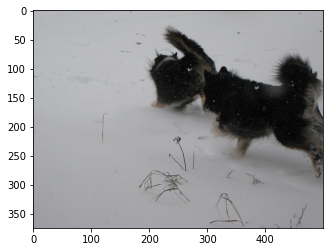

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3122606953.jpg
Real Caption: two dogs of the same breed are running through snow that has buried grass
Predicted Caption: two dogs are playing in the snow
BLEU-1 score: 26.277102940817308
BLEU-2 score: 12.693046617126203
BLEU-3 score: 9.831619486768305e-92
BLEU-4 score: 3.223353320272037e-153


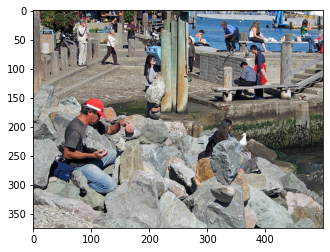

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2995173839.jpg
Real Caption: man is stacking rocks by the waterfront
Predicted Caption: group of people sitting on the water
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


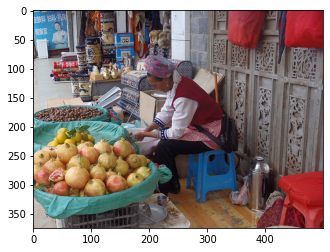

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/8018752014.jpg
Real Caption: an older food vendor in white <unk> shirt maroon vest and checked apron is sitting leaning forward with her <unk> on her knees and her hands <unk> behind her <unk>
Predicted Caption: woman is sitting on the side of produce
BLEU-1 score: 2.397294795251534
BLEU-2 score: 1.4796424710159957
BLEU-3 score: 1.3445392121266538e-92
BLEU-4 score: 4.587707254359935e-154


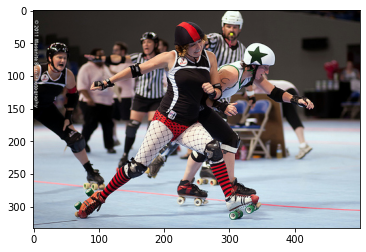

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6213858694.jpg
Real Caption: two women <unk> into each other during roller derby game
Predicted Caption: two women are competing in roller derby
BLEU-1 score: 37.225089001774606
BLEU-2 score: 28.431131350350043
BLEU-3 score: 2.0046074122345223e-91
BLEU-4 score: 6.419573613943771e-153


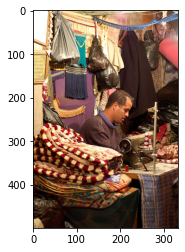

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/86800579.jpg
Real Caption: man sits at sewing machine surrounded by items
Predicted Caption: woman is sitting at table with
BLEU-1 score: 11.942188509563156
BLEU-2 score: 4.3634676769543673e-153
BLEU-3 score: 1.072004124838459e-183
BLEU-4 score: 8.34076112986429e-230


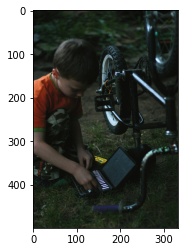

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1465531335.jpg
Real Caption: young boy next to bike that turned upside down is handling <unk> <unk> set that is set next to the bike
Predicted Caption: man in blue shirt and white shirt is holding large stick
BLEU-1 score: 3.662639286628481
BLEU-2 score: 1.8120188355374236e-153
BLEU-3 score: 5.025458465022252e-184
BLEU-4 score: 4.030389204643943e-230


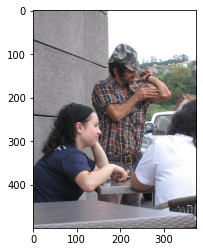

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4063590558.jpg
Real Caption: man is outside and pulling on his arm
Predicted Caption: man is sitting on the floor
BLEU-1 score: 35.826565528689464
BLEU-2 score: 22.65870956238665
BLEU-3 score: 1.8173496937128004e-91
BLEU-4 score: 6.0104555320873e-153


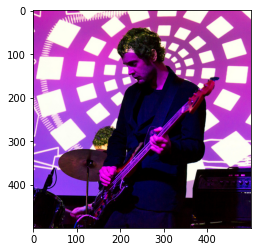

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7032796325.jpg
Real Caption: playing the guitar in front of the color purple
Predicted Caption: man in black shirt playing the guitar
BLEU-1 score: 42.94155960430205
BLEU-2 score: 32.797157891028675
BLEU-3 score: 28.19532273037056
BLEU-4 score: 4.054801917798201e-76


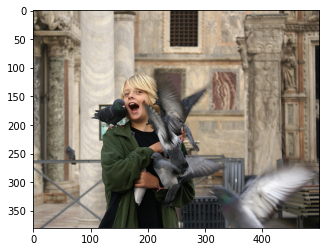

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2101808682.jpg
Real Caption: pigeons attack blond boy
Predicted Caption: man in black jacket and woman in front of them
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


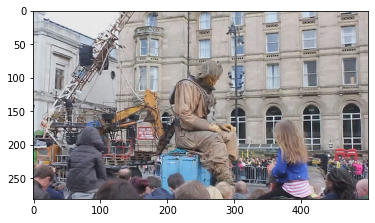

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6953548178.jpg
Real Caption: crowd of people surrounded by large buildings are watching large statue of sitting man
Predicted Caption: crowd of people are walking down the street
BLEU-1 score: 23.618327637050733
BLEU-2 score: 17.853777517394295
BLEU-3 score: 15.392329493601862
BLEU-4 score: 2.2662244658785515e-76


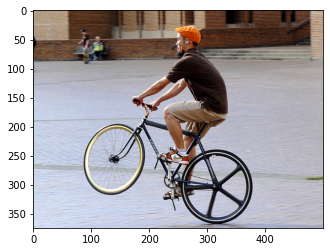

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/990890291.jpg
Real Caption: asian man in orange hat is popping wheelie on his bike
Predicted Caption: man in blue shirt riding bicycle down the street
BLEU-1 score: 17.794164509262398
BLEU-2 score: 13.3456233819468
BLEU-3 score: 1.382937949398001e-91
BLEU-4 score: 4.876258334835267e-153


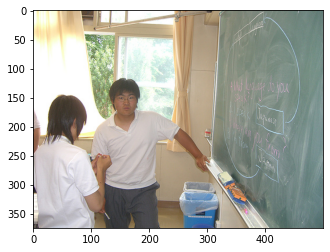

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/841397013.jpg
Real Caption: two young adults are working on chalkboard
Predicted Caption: two men are standing in an aquarium while man in the background
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


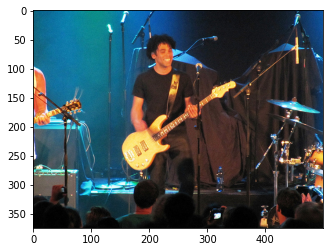

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4810489376.jpg
Real Caption: man in black shirt playing guitar in band
Predicted Caption: man with glasses and white guitar
BLEU-1 score: 23.88437701912631
BLEU-2 score: 6.17087516772532e-153
BLEU-3 score: 1.319791889377583e-183
BLEU-4 score: 9.918892480173173e-230


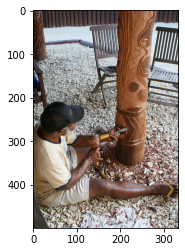

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4757316872.jpg
Real Caption: man is working on decorative wood piece
Predicted Caption: man is using chainsaw to
BLEU-1 score: 26.812801841425575
BLEU-2 score: 21.19738106741542
BLEU-3 score: 1.7001433327133957e-91
BLEU-4 score: 5.622823133489599e-153


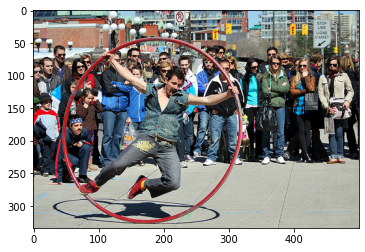

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4509404105.jpg
Real Caption: street performer does stunts with large red hoop
Predicted Caption: man in black shirt and black pants perform trick on the crowd
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


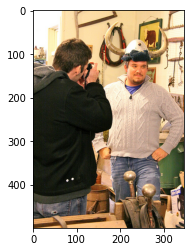

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4094636248.jpg
Real Caption: man wearing <unk> hat poses for picture
Predicted Caption: man in blue shirt and black shirt is holding up to the background
BLEU-1 score: 7.6923076923076925
BLEU-2 score: 4.1371430671115044e-153
BLEU-3 score: 1.1863795531178766e-183
BLEU-4 score: 9.594503055152631e-230


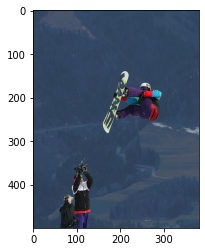

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5075833333.jpg
Real Caption: two people taking pictures of person snowboarding in air
Predicted Caption: man in red and yellow and white suit
BLEU-1 score: 11.031211282307446
BLEU-2 score: 4.6541503835249794e-153
BLEU-3 score: 1.2111358303072744e-183
BLEU-4 score: 9.55980462367717e-230


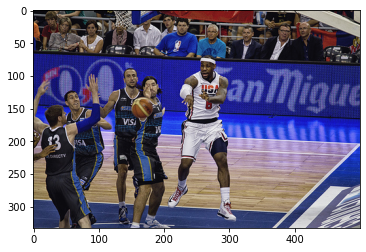

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7693594898.jpg
Real Caption: <unk> <unk> in the olympics against <unk> passing the ball under the basket
Predicted Caption: volleyball team of volleyball teams are playing volleyball
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


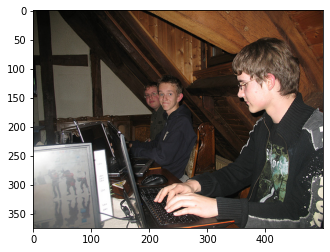

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2105893101.jpg
Real Caption: three boys are sitting by several laptops
Predicted Caption: man in black shirt is sitting on the other people
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


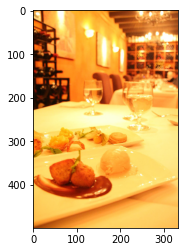

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/105493628.jpg
Real Caption: white wine and <unk> on are displayed in an <unk> restaurant
Predicted Caption: woman is eating at table eating with chopsticks
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


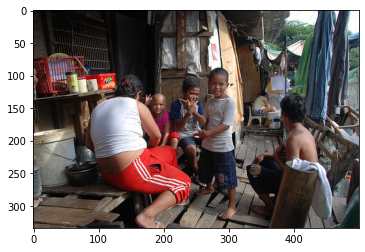

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4969485553.jpg
Real Caption: woman and four young boys gather on the porch of somewhat <unk> wooden house
Predicted Caption: man in blue shirt is standing around him
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


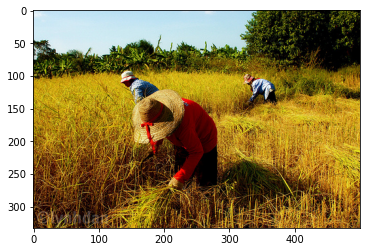

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3083913737.jpg
Real Caption: asian workers <unk> in field
Predicted Caption: two people are walking through field
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


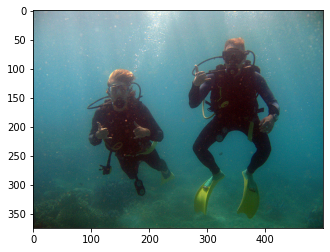

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3023927196.jpg
Real Caption: two men in scuba gear are making hand signals at the camera from underwater
Predicted Caption: two scuba divers underwater wearing scuba dive in the water
BLEU-1 score: 33.51600230178197
BLEU-2 score: 7.070325777244754e-153
BLEU-3 score: 1.3943758982111602e-183
BLEU-4 score: 1.0269115342717183e-229


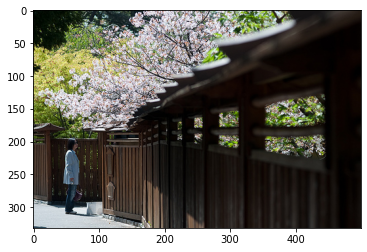

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4573386995.jpg
Real Caption: woman wearing blue jacket standing in front of brown fence
Predicted Caption: man in black shirt and black pants stands in front of building
BLEU-1 score: 25.0
BLEU-2 score: 21.320071635561042
BLEU-3 score: 19.827739103386627
BLEU-4 score: 3.171249689059254e-76


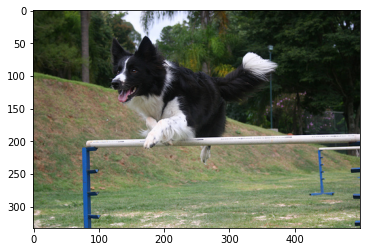

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/458213442.jpg
Real Caption: dog jumps over hurdle on grass field
Predicted Caption: dog jumps over an obstacle
BLEU-1 score: 40.21920276213836
BLEU-2 score: 36.71494099616211
BLEU-3 score: 33.59558495175079
BLEU-4 score: 4.6038197862150135e-76


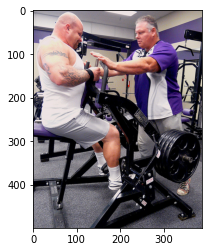

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5311177343.jpg
Real Caption: fitness trainer is working with man on an athletic machine
Predicted Caption: two men in black and black shorts is playing the other people
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


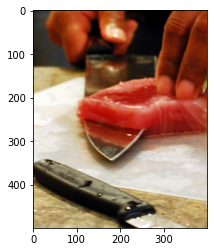

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3831892579.jpg
Real Caption: someone is preparing meal
Predicted Caption: man is painting on project
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


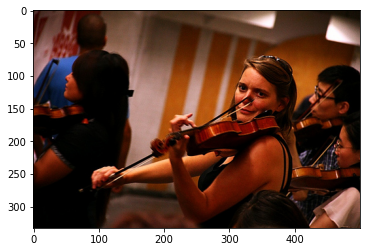

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6082587848.jpg
Real Caption: female violinist surrounded by other violinists
Predicted Caption: two men are playing guitar
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


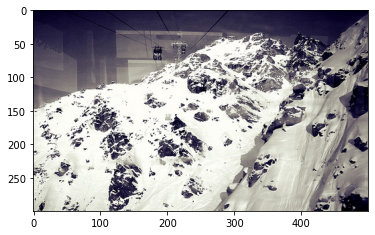

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3259110412.jpg
Real Caption: beautiful mountain scenery and ski lift
Predicted Caption: person is climbing an empty mountain
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


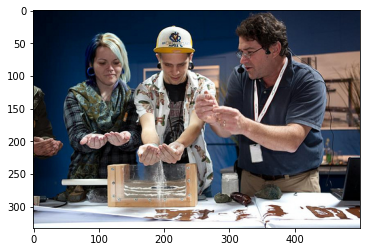

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6681702979.jpg
Real Caption: three people standing in front of table with their hands outstretched
Predicted Caption: three men are sitting around table with their hands
BLEU-1 score: 44.485411273156004
BLEU-2 score: 36.548494851303225
BLEU-3 score: 34.34767386841722
BLEU-4 score: 25.271148634948986


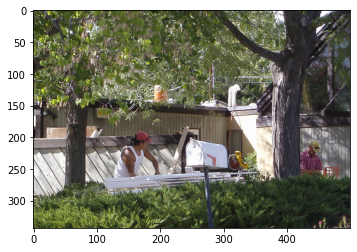

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3890223491.jpg
Real Caption: man with white and red hat is working outside house
Predicted Caption: man and woman are sitting on bench in park
BLEU-1 score: 19.885318151430436
BLEU-2 score: 6.29232312294398e-153
BLEU-3 score: 1.4594457704885681e-183
BLEU-4 score: 1.1193096620723277e-229


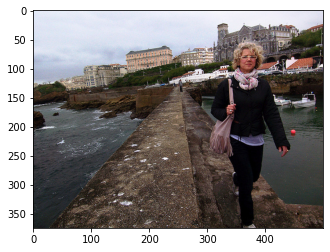

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4586247564.jpg
Real Caption: lady walking along concrete pathway above the ocean
Predicted Caption: woman in white shirt and black jacket walking down the street
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


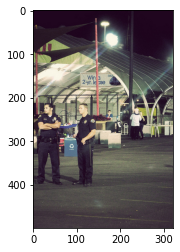

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3969232921.jpg
Real Caption: two policemen standing in parking lot
Predicted Caption: man in blue shirt and black pants stands in front of an outdoor market
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230


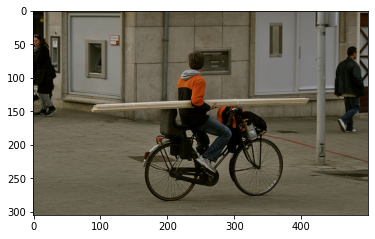

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4443934130.jpg
Real Caption: man in rides bicycle carrying pipes in his hand
Predicted Caption: man in blue shirt riding bicycle
BLEU-1 score: 30.326532985631673
BLEU-2 score: 19.180183554164504
BLEU-3 score: 1.5383533034634404e-91
BLEU-4 score: 5.087740766179591e-153


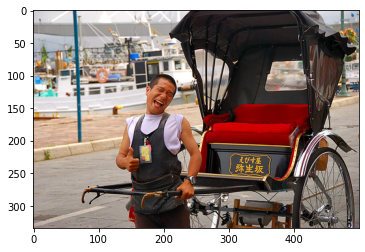

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1231348815.jpg
Real Caption: an asian man posing in front of cart <unk> pulling for picture
Predicted Caption: man in blue shirt and blue shirt and blue jeans and white shirt and blue and blue shirt and blue shirt and blue shirt and blue jeans and blue shirt on the car
BLEU-1 score: 6.060606060606061
BLEU-2 score: 3.6722331233414005e-153
BLEU-3 score: 1.1044892051005175e-183
BLEU-4 score: 9.039352811507815e-230


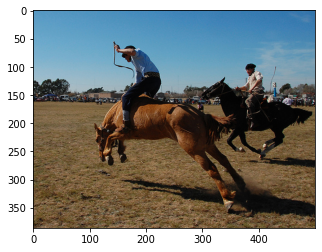

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2314684787.jpg
Real Caption: two men riding horses at an event
Predicted Caption: two men on horseback trying to ride
BLEU-1 score: 28.57142857142857
BLEU-2 score: 21.82178902359924
BLEU-3 score: 2.030194004994321e-91
BLEU-4 score: 6.968148412761693e-153


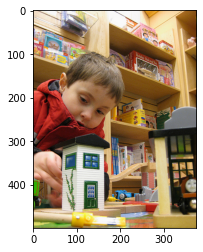

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3125809653.jpg
Real Caption: boy in red coat is playing with train set
Predicted Caption: young boy in the blue shirt is playing with his head on the background
BLEU-1 score: 35.71428571428572
BLEU-2 score: 28.70846258816073
BLEU-3 score: 22.44148478285166
BLEU-4 score: 3.5159748842679174e-76


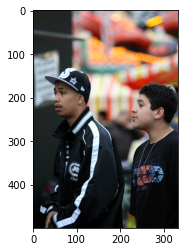

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1417882092.jpg
Real Caption: two men are watching something
Predicted Caption: man in black shirt that says
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


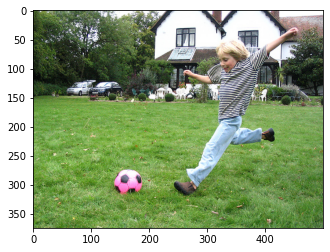

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/428258615.jpg
Real Caption: child wearing striped shirt is in the middle of kicking pink soccer ball
Predicted Caption: young boy is kicking ball in the grass
BLEU-1 score: 33.453839282436896
BLEU-2 score: 15.993994320977341
BLEU-3 score: 1.312211596419387e-91
BLEU-4 score: 4.364491568564534e-153


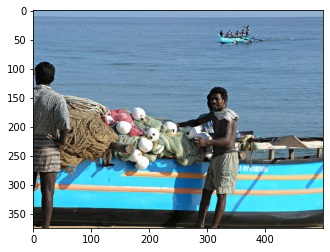

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/334052203.jpg
Real Caption: three or two fishermen are standing next to very bright aqua colored boat with yellow <unk> that has <unk> ropes and nets and an identical boat with people in the water in the distance
Predicted Caption: two men are sitting on the water
BLEU-1 score: 1.2073302789247593
BLEU-2 score: 0.6520328729206502
BLEU-3 score: 5.280933284167024e-93
BLEU-4 score: 1.7508100551722477e-154


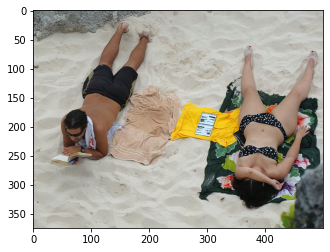

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6155718367.jpg
Real Caption: at the beach man is laying on his stomach and reading book while woman in bikini <unk>
Predicted Caption: man and son are laying on the beach
BLEU-1 score: 24.348935051876232
BLEU-2 score: 15.028488986055619
BLEU-3 score: 1.0349515111432188e-91
BLEU-4 score: 3.294877163878425e-153


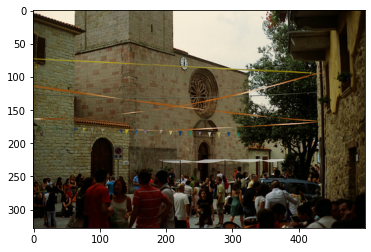

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4775810124.jpg
Real Caption: large group of people are standing between buildings outside
Predicted Caption: people are walking in front of building
BLEU-1 score: 32.206169703226536
BLEU-2 score: 20.084075461628778
BLEU-3 score: 1.7229821612226873e-91
BLEU-4 score: 5.795035077445241e-153


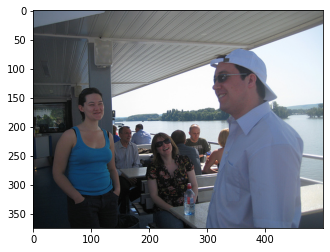

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3578366714.jpg
Real Caption: people converse the day while aboard floating restaurant
Predicted Caption: group of people are standing in front of people
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


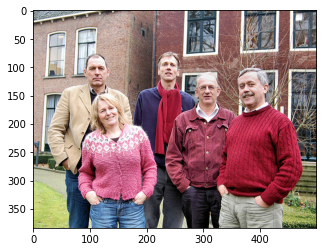

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3254817653.jpg
Real Caption: group shot of four guys and one girl in front of brick building
Predicted Caption: three women are posing for picture
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


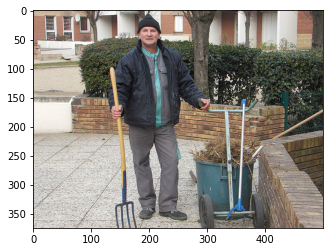

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/115275691.jpg
Real Caption: an elderly man holding <unk> and doing some yard work
Predicted Caption: man in blue shirt and black striped shirt and holding camera
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229


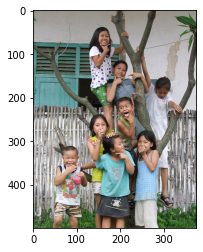

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3614595423.jpg
Real Caption: several children are in tree laughing and with their hands on their <unk>
Predicted Caption: group of people are sitting on the grass
BLEU-1 score: 13.381535712974756
BLEU-2 score: 3.9921621141636406e-153
BLEU-3 score: 9.043876231738548e-184
BLEU-4 score: 6.895396983435736e-230


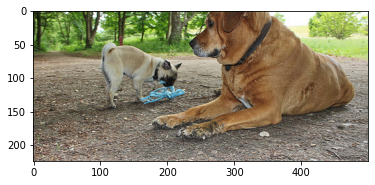

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3610189629.jpg
Real Caption: small dog chews on blue shoe next to large dog
Predicted Caption: two dogs are standing on the dirt
BLEU-1 score: 9.306272250443651
BLEU-2 score: 3.672797542504966e-153
BLEU-3 score: 9.305742700321069e-184
BLEU-4 score: 7.296382734947758e-230


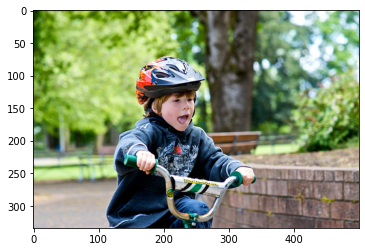

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3549583146.jpg
Real Caption: young boy has his mouth open as he rides his bike outdoors past stone wall
Predicted Caption: young boy wearing helmet is riding bike
BLEU-1 score: 13.667423885313019
BLEU-2 score: 8.523136256442008
BLEU-3 score: 7.311868428086932e-92
BLEU-4 score: 2.459255526613182e-153


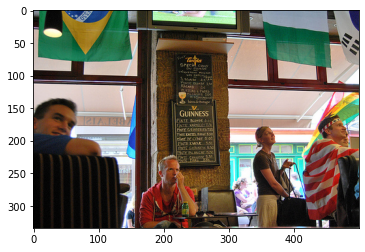

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4730789283.jpg
Real Caption: people watching soccer game at the local watering hole
Predicted Caption: man in blue shirt is standing in front of
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


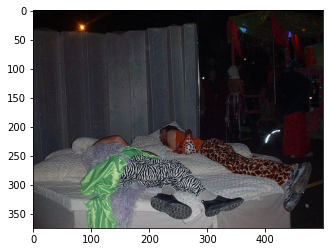

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/270684372.jpg
Real Caption: two men in animal print pajama bottoms sleep on bed
Predicted Caption: man sleeping on couch
BLEU-1 score: 5.578254003710746
BLEU-2 score: 1.664180761794279e-153
BLEU-3 score: 3.7700485116849887e-184
BLEU-4 score: 2.8744291130001146e-230


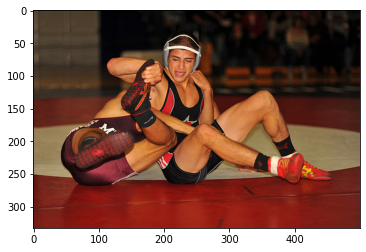

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/8111420340.jpg
Real Caption: two wrestlers competing in match
Predicted Caption: two wrestlers in wrestling on the floor
BLEU-1 score: 42.857142857142854
BLEU-2 score: 26.726124191242434
BLEU-3 score: 2.2927933779232266e-91
BLEU-4 score: 7.711523862191632e-153


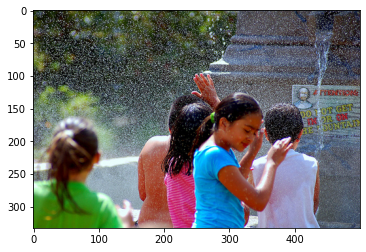

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/571507143.jpg
Real Caption: children are being splashed with water
Predicted Caption: group of children are sitting on the park
BLEU-1 score: 25.0
BLEU-2 score: 18.898223650461357
BLEU-3 score: 1.8623269155678368e-91
BLEU-4 score: 6.484592771860511e-153


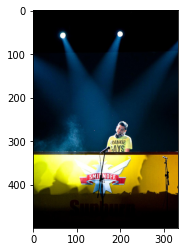

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2199710546.jpg
Real Caption: this is man who is at dj booth
Predicted Caption: man in black shirt and black vest is standing on the air
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


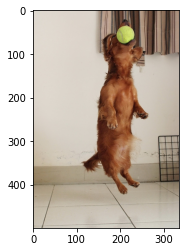

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/724702877.jpg
Real Caption: small brown dog jumps and catches tennis ball
Predicted Caption: dog jumps up to catch tennis ball
BLEU-1 score: 49.53587998572467
BLEU-2 score: 37.833653275138545
BLEU-3 score: 2.667555534553847e-91
BLEU-4 score: 8.542604910486143e-153


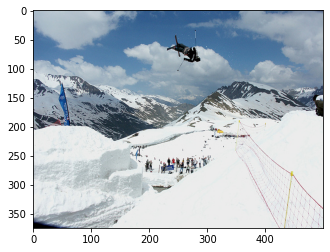

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/513116697.jpg
Real Caption: skier jumps over gap
Predicted Caption: snowboarder is jumping in the air over snow
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


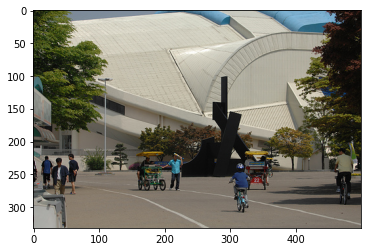

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3497217792.jpg
Real Caption: complex building is in the background with people standing around and some riding bikes
Predicted Caption: man in white shirt and black shirt and one man in the street
BLEU-1 score: 21.368332584053448
BLEU-2 score: 12.840769800495439
BLEU-3 score: 1.4321716035921135e-91
BLEU-4 score: 5.1435635729606e-153


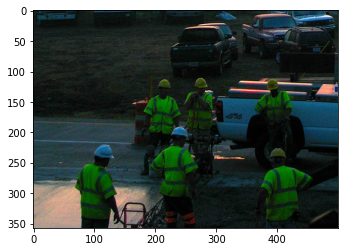

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2598093366.jpg
Real Caption: group of workers huddles around outside
Predicted Caption: two men in hard hats work on the road
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


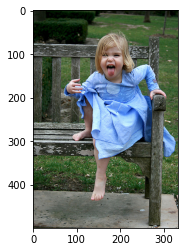

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2531531628.jpg
Real Caption: girl sticks out her tongue on bench
Predicted Caption: young boy in blue shirt and blue jeans and blue and white shirt
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


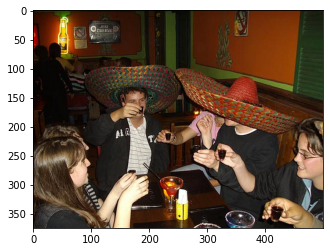

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2900560501.jpg
Real Caption: group of people taking shots at restaurant
Predicted Caption: group of people are sitting around table in front of them
BLEU-1 score: 27.27272727272727
BLEU-2 score: 23.35496832484569
BLEU-3 score: 21.61497894047949
BLEU-4 score: 3.4077295621678845e-76


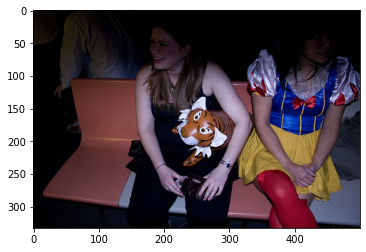

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3016521240.jpg
Real Caption: girls sit in costumes
Predicted Caption: two girls are posing with red dress and one in the other is holding
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


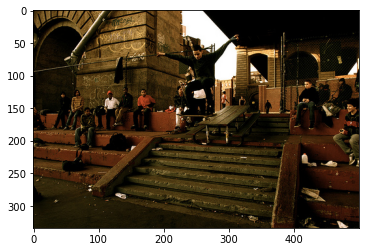

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3283913180.jpg
Real Caption: onlookers watch as man on skateboard attempts trick off table sitting on stairs
Predicted Caption: two people are sitting on the steps
BLEU-1 score: 12.124938447912854
BLEU-2 score: 9.260574705706839
BLEU-3 score: 8.61559207175724e-92
BLEU-4 score: 2.9570929710230013e-153


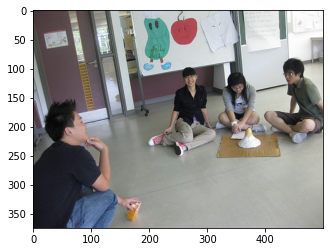

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4329267374.jpg
Real Caption: four asian people sitting on the floor with model of <unk>
Predicted Caption: group of people are sitting on the floor
BLEU-1 score: 51.546695909322914
BLEU-2 score: 38.965639509468254
BLEU-3 score: 35.1664505782902
BLEU-4 score: 26.295889981470587


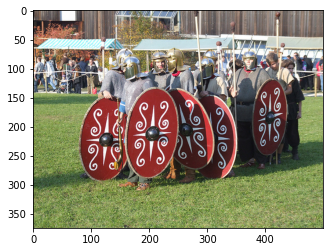

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2893518092.jpg
Real Caption: this picture shows group of soldiers in body armor with red shields
Predicted Caption: group of people are standing in front of them are holding flags
BLEU-1 score: 25.0
BLEU-2 score: 15.075567228888179
BLEU-3 score: 1.6261759223357467e-91
BLEU-4 score: 5.791739854583281e-153


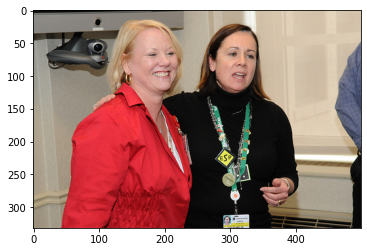

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4379578964.jpg
Real Caption: woman in black puts her arm around another woman while their photo is taken
Predicted Caption: two women are posing for picture
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


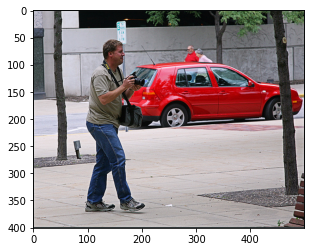

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/906991263.jpg
Real Caption: man close to red car is taking pictures
Predicted Caption: man in blue shirt and black pants and blue jeans and holding camera
BLEU-1 score: 7.6923076923076925
BLEU-2 score: 4.1371430671115044e-153
BLEU-3 score: 1.1863795531178766e-183
BLEU-4 score: 9.594503055152631e-230


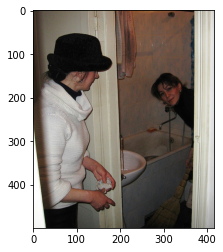

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2432584943.jpg
Real Caption: woman holding broom in small bathroom another woman is right outside the door speaking with her
Predicted Caption: man in black shirt is putting on the bathroom door
BLEU-1 score: 27.44058180470132
BLEU-2 score: 5.788693148110264e-153
BLEU-3 score: 1.1416184292162104e-183
BLEU-4 score: 8.407640537987497e-230


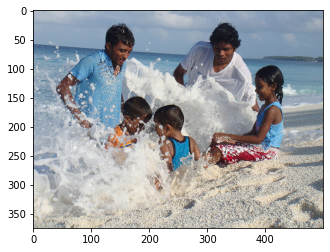

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2922504002.jpg
Real Caption: men and children getting splashed by water on the beach
Predicted Caption: four children are playing in the beach
BLEU-1 score: 27.91881675133095
BLEU-2 score: 17.410441154600917
BLEU-3 score: 1.493615157227752e-91
BLEU-4 score: 5.023587836914362e-153


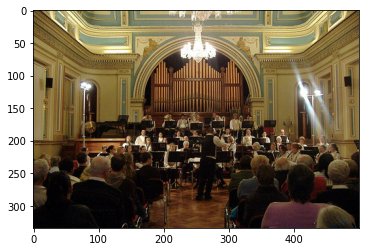

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3472419481.jpg
Real Caption: an orchestra is performing for crowd of people
Predicted Caption: group of people are sitting at tables in front of people
BLEU-1 score: 18.181818181818183
BLEU-2 score: 13.483997249264846
BLEU-3 score: 1.5208785072510163e-91
BLEU-4 score: 5.477489369001354e-153


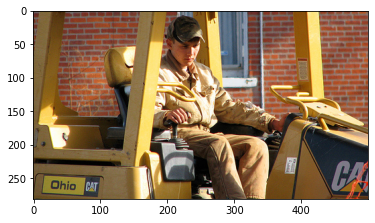

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/324641725.jpg
Real Caption: this man studies the controls while working with heavy machinery
Predicted Caption: man in blue shirt is sitting on the street
BLEU-1 score: 19.885318151430436
BLEU-2 score: 6.29232312294398e-153
BLEU-3 score: 1.4594457704885681e-183
BLEU-4 score: 1.1193096620723277e-229


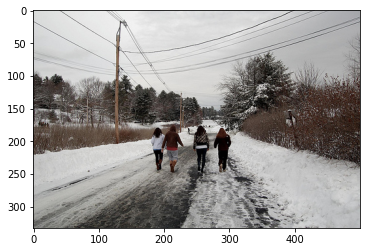

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3214333978.jpg
Real Caption: four women are taking walk down an icy road
Predicted Caption: group of crosscountry skiers following path in the snow
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


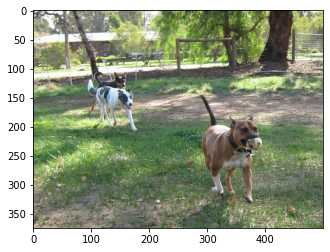

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3329777647.jpg
Real Caption: three dogs play in the park with the brown dog getting the ball
Predicted Caption: two dogs are running in the grass
BLEU-1 score: 18.18740767186928
BLEU-2 score: 11.341841376953123
BLEU-3 score: 9.729992503385463e-92
BLEU-4 score: 3.272561325903966e-153


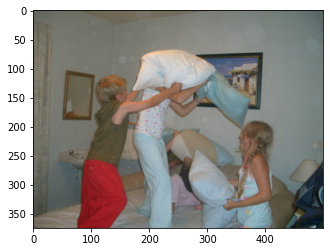

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1055623002.jpg
Real Caption: group of young children playing pillow fight on bed
Predicted Caption: two children are sitting on the floor
BLEU-1 score: 21.470779802151025
BLEU-2 score: 5.991755122558557e-153
BLEU-3 score: 1.3216063232004421e-183
BLEU-4 score: 1.0009379942300741e-229


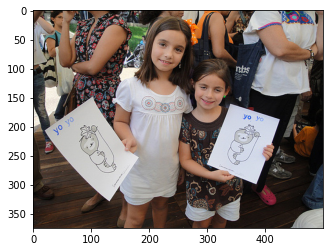

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5781162449.jpg
Real Caption: two young girls holding pictures of <unk> in crowd of people
Predicted Caption: group of children are sitting on the camera
BLEU-1 score: 8.591115984887153
BLEU-2 score: 3.6246559632213337e-153
BLEU-3 score: 9.432335330491414e-184
BLEU-4 score: 7.445183326929417e-230


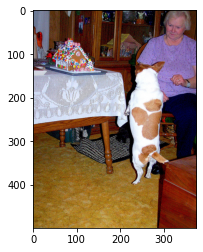

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3154813159.jpg
Real Caption: dog stands on his hind legs for lady in purple
Predicted Caption: dog jumps onto the stairs
BLEU-1 score: 7.357588823428847
BLEU-2 score: 2.454102690856474e-153
BLEU-3 score: 5.813279118387829e-184
BLEU-4 score: 4.481994719908145e-230


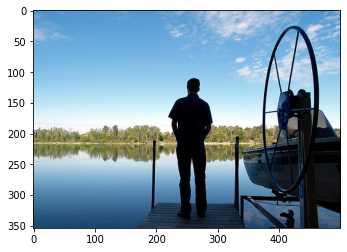

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1588931550.jpg
Real Caption: the man is looking out over <unk> lake
Predicted Caption: man stands on the beach watching boat
BLEU-1 score: 24.767939992862335
BLEU-2 score: 6.911878967366998e-153
BLEU-3 score: 1.5245587914760605e-183
BLEU-4 score: 1.154647032204335e-229


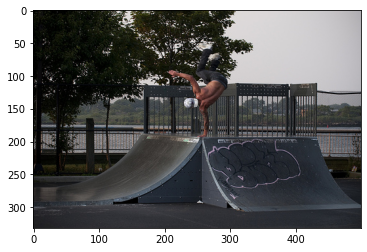

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3728015645.jpg
Real Caption: young man is skateboarding on ramp and is standing on one arm
Predicted Caption: skateboarder is doing trick on rail
BLEU-1 score: 12.262648039048077
BLEU-2 score: 3.168232950523297e-153
BLEU-3 score: 6.776037495668201e-184
BLEU-4 score: 5.092529201164552e-230


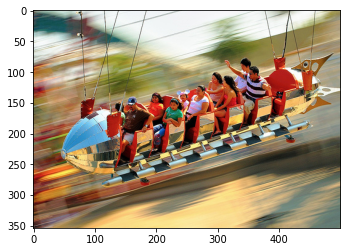

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3928848343.jpg
Real Caption: group of children and adults are riding carnival ride
Predicted Caption: group of people are riding on the
BLEU-1 score: 42.94155960430205
BLEU-2 score: 32.797157891028675
BLEU-3 score: 2.3124449392610116e-91
BLEU-4 score: 7.405395403197815e-153


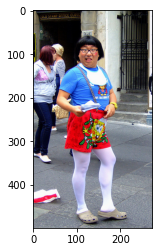

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4935646855.jpg
Real Caption: man is standing in the street wearing an elaborate outfit which includes blue suspenders and purple tights
Predicted Caption: woman in red and white dress is walking down the street
BLEU-1 score: 26.344467217491342
BLEU-2 score: 12.35665042210731
BLEU-3 score: 1.1603489830213731e-91
BLEU-4 score: 3.991890743256307e-153


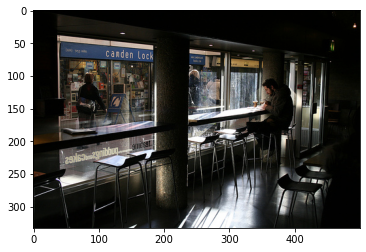

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/97495047.jpg
Real Caption: man sits alone with his drink at long table in darkened cafe overlooking busy shopping mall
Predicted Caption: man in suit is sitting in front of an elevator
BLEU-1 score: 10.976232721880528
BLEU-2 score: 3.6610910047675876e-153
BLEU-3 score: 8.672393363093234e-184
BLEU-4 score: 6.686350417856737e-230


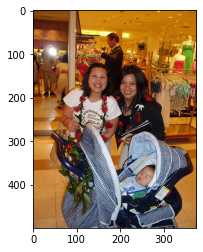

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/141213544.jpg
Real Caption: two women with black hair wearing flower <unk> standing in store with baby in baby stroller
Predicted Caption: woman with black shirt is sitting on the camera
BLEU-1 score: 10.209462756353926
BLEU-2 score: 7.657097067265445
BLEU-3 score: 7.934653791347139e-92
BLEU-4 score: 2.797769900011153e-153


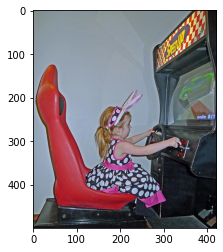

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5701786491.jpg
Real Caption: young girl wearing bunny ears takes the wheel on video racing game
Predicted Caption: young girl in pink dress is playing the floor
BLEU-1 score: 23.88437701912631
BLEU-2 score: 14.62613413027904
BLEU-3 score: 1.3975750202079033e-91
BLEU-4 score: 4.828970785282295e-153


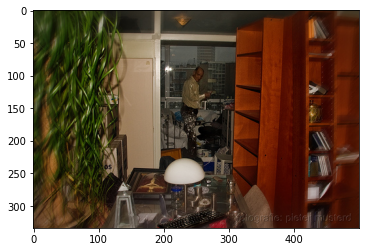

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3272845728.jpg
Real Caption: man is standing in room cluttered with furniture
Predicted Caption: man in blue shirt is working on building
BLEU-1 score: 37.5
BLEU-2 score: 9.134564559628536e-153
BLEU-3 score: 1.9081654987219002e-183
BLEU-4 score: 1.4256605770826505e-229


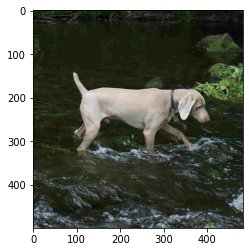

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1490213660.jpg
Real Caption: tan dog walking along in stream
Predicted Caption: dog with stick in the water
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


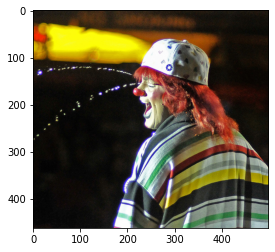

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2811917688.jpg
Real Caption: clown cries <unk> of <unk> in white hat on stage
Predicted Caption: man in red hat and red hat is wearing red and red
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


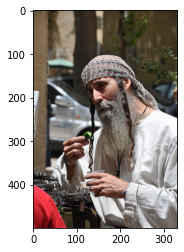

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4782776184.jpg
Real Caption: an older man with long beard wearing white shirt about to eat
Predicted Caption: an older man with beard and
BLEU-1 score: 30.656620097620195
BLEU-2 score: 26.013004751144447
BLEU-3 score: 24.270991641821485
BLEU-4 score: 19.765609300943975


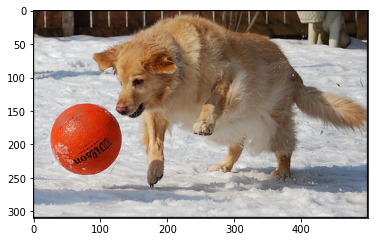

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2304374703.jpg
Real Caption: the dog tries to play with basketball in the snow
Predicted Caption: brown dog is shaking water off water
BLEU-1 score: 9.306272250443651
BLEU-2 score: 3.672797542504966e-153
BLEU-3 score: 9.305742700321069e-184
BLEU-4 score: 7.296382734947758e-230


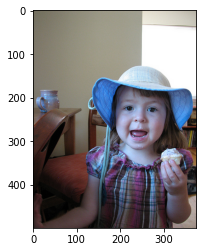

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3829206624.jpg
Real Caption: little girl in blue hat is eating cupcake
Predicted Caption: young boy in blue shirt with red bandanna on his head
BLEU-1 score: 18.181818181818183
BLEU-2 score: 13.483997249264846
BLEU-3 score: 1.5208785072510163e-91
BLEU-4 score: 5.477489369001354e-153


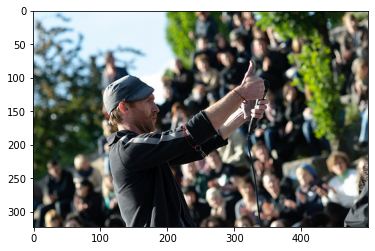

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5738179350.jpg
Real Caption: man giving two thumbs up to crowd
Predicted Caption: man with glasses is holding chicken
BLEU-1 score: 14.108028748176901
BLEU-2 score: 5.154827976372712e-153
BLEU-3 score: 1.2664232355128374e-183
BLEU-4 score: 9.853445011990207e-230


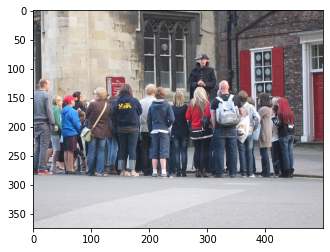

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5687833791.jpg
Real Caption: large group gathers as man in period clothing gives tour
Predicted Caption: group of people are standing in front of building
BLEU-1 score: 19.885318151430436
BLEU-2 score: 6.29232312294398e-153
BLEU-3 score: 1.4594457704885681e-183
BLEU-4 score: 1.1193096620723277e-229


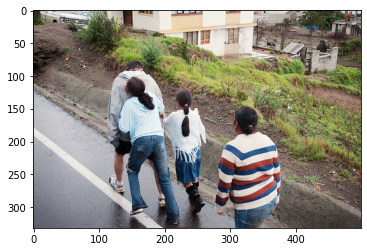

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3346992806.jpg
Real Caption: one man wearing shorts and three girls are walking down the road
Predicted Caption: group of people are walking down the street
BLEU-1 score: 30.326532985631673
BLEU-2 score: 28.076913794513086
BLEU-3 score: 27.47984940312521
BLEU-4 score: 20.969025558524574


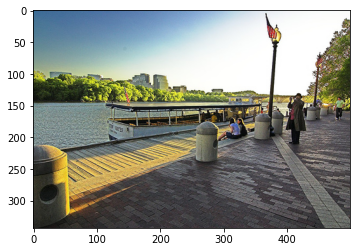

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/508775668.jpg
Real Caption: boat docked on river
Predicted Caption: people walking on the beach
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


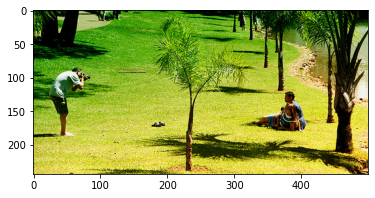

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7117181861.jpg
Real Caption: barefoot man is photographing couple who is laying in the green grass under some palm trees by water
Predicted Caption: man and woman are walking in park
BLEU-1 score: 5.935662489817165
BLEU-2 score: 1.6564389582896117e-153
BLEU-3 score: 3.65362094493659e-184
BLEU-4 score: 2.767123579921893e-230


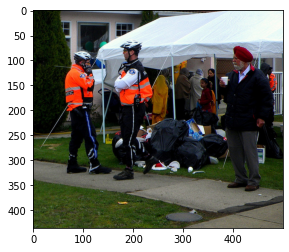

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3432637363.jpg
Real Caption: two officers with orange jackets stand outside white tent with onlookers
Predicted Caption: man in black shirt is playing music in front of people
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


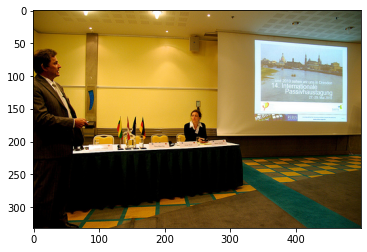

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4705913066.jpg
Real Caption: man in suit presents presentation to woman wearing black
Predicted Caption: man in suit is sitting at podium
BLEU-1 score: 32.206169703226536
BLEU-2 score: 28.4031719055601
BLEU-3 score: 25.863985552473196
BLEU-4 score: 3.773418367399459e-76


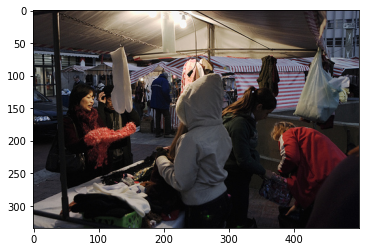

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4702967745.jpg
Real Caption: woman is shopping in the night street market
Predicted Caption: man in black shirt is standing in front of an outdoor tables
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


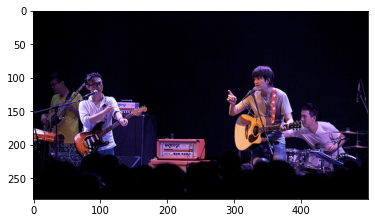

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7936399880.jpg
Real Caption: band is performing on stage
Predicted Caption: group of people playing music on stage
BLEU-1 score: 28.57142857142857
BLEU-2 score: 21.82178902359924
BLEU-3 score: 2.030194004994321e-91
BLEU-4 score: 6.968148412761693e-153


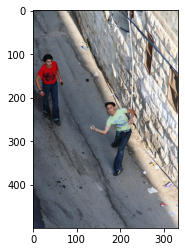

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/526619673.jpg
Real Caption: this man is throwing rock
Predicted Caption: man in blue shirt and blue jeans and one of graffiti
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


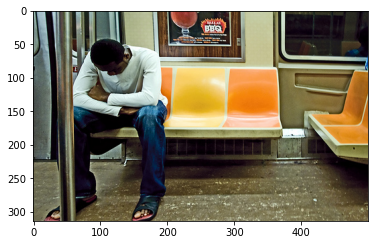

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4042673790.jpg
Real Caption: man in sandals sits on yellow and orange seats on public transit
Predicted Caption: man in blue shirt is sitting on the subway
BLEU-1 score: 23.88437701912631
BLEU-2 score: 14.62613413027904
BLEU-3 score: 1.3975750202079033e-91
BLEU-4 score: 4.828970785282295e-153


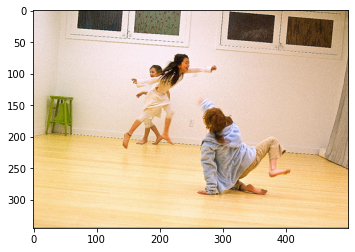

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3673878924.jpg
Real Caption: three girls dance on wooden floor
Predicted Caption: two girls are dancing on the air
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229


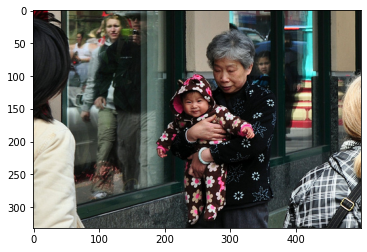

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4889441439.jpg
Real Caption: grandmother holding on to her adorable <unk> in flower print brown <unk>
Predicted Caption: woman with in front of an older woman in front of people
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


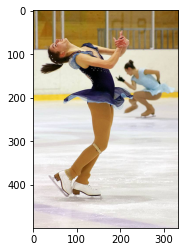

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6759038111.jpg
Real Caption: two figure skaters practicing their <unk> on the ice
Predicted Caption: female figure skater in blue leotard performs ribbon
BLEU-1 score: 11.031211282307446
BLEU-2 score: 4.6541503835249794e-153
BLEU-3 score: 1.2111358303072744e-183
BLEU-4 score: 9.55980462367717e-230


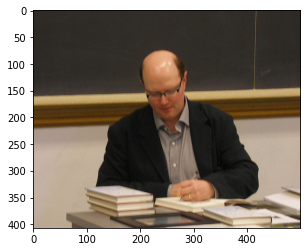

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/352024192.jpg
Real Caption: the <unk> signs several <unk> of his <unk>
Predicted Caption: man in suit is sitting at desk with his computer keyboard
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


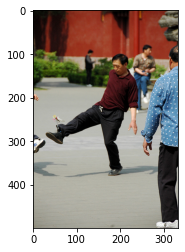

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3490613884.jpg
Real Caption: an asian man wearing black pants is kicking toy
Predicted Caption: two men are dancing in the street
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


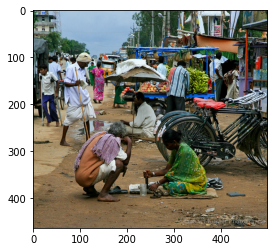

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3904368912.jpg
Real Caption: farmers market where people show their skills and goods
Predicted Caption: man in blue shirt is sitting on the side of people
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


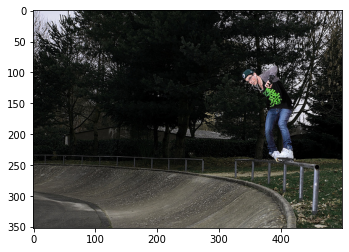

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5479743540.jpg
Real Caption: man wearing jeans along sleeve and glasses is standing on low metal railing
Predicted Caption: skateboarder is doing trick on rail
BLEU-1 score: 10.380107463819924
BLEU-2 score: 2.6818512928142403e-153
BLEU-3 score: 5.735791907256696e-184
BLEU-4 score: 4.3107329022575925e-230


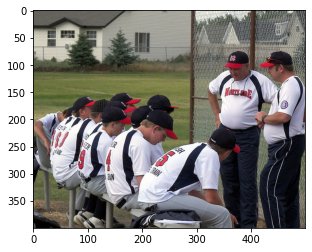

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/573594802.jpg
Real Caption: coach of youth baseball team speaks to the players
Predicted Caption: man in blue shirt is pointing at an outdoor event
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


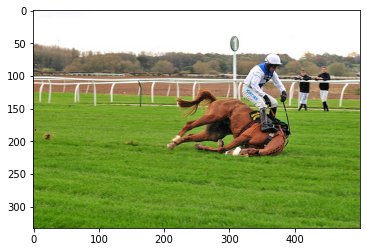

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/8137819284.jpg
Real Caption: <unk> and jockey falling on grass track
Predicted Caption: man in black horse in field
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


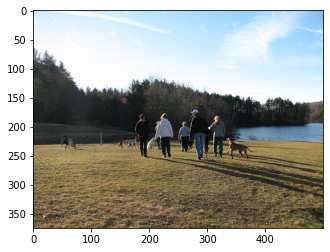

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/349738327.jpg
Real Caption: group of people walk in park by body of water with some dogs
Predicted Caption: group of people are walking down hill
BLEU-1 score: 18.18740767186928
BLEU-2 score: 16.03978589757145
BLEU-3 score: 14.60586134882848
BLEU-4 score: 2.1309177339874075e-76


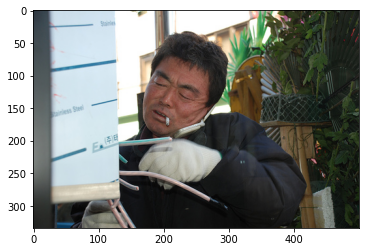

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2162746678.jpg
Real Caption: asian man smoking while on the phone
Predicted Caption: man in blue shirt is sitting on the newspaper
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153


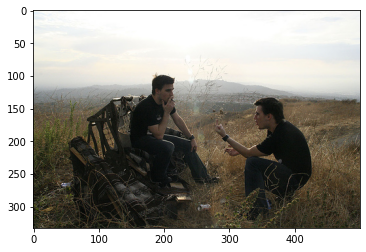

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/192486925.jpg
Real Caption: two young men are dressed in black sharing cigarette in the <unk> grass
Predicted Caption: three people sitting on grassy plain
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


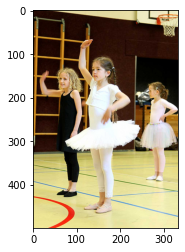

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4548082171.jpg
Real Caption: three young girls participate in ballet <unk>
Predicted Caption: two women in white are dancing on stage
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


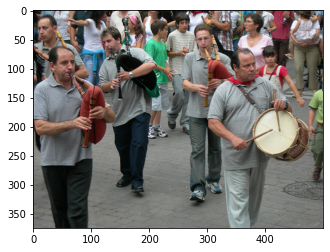

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/203062683.jpg
Real Caption: several men in gray collared shirts walking down the street three of which are playing bagpipes and one drum
Predicted Caption: man in black shirt and black shirt is playing the street
BLEU-1 score: 21.964776417719335
BLEU-2 score: 10.30239334706688
BLEU-3 score: 9.674443505796379e-92
BLEU-4 score: 3.328250555827247e-153


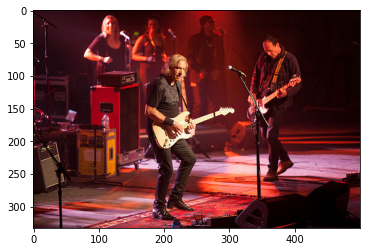

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7265523810.jpg
Real Caption: five performers in black are on stage lit by bright red stage lights
Predicted Caption: band of men playing music on stage
BLEU-1 score: 12.124938447912854
BLEU-2 score: 9.260574705706839
BLEU-3 score: 8.61559207175724e-92
BLEU-4 score: 2.9570929710230013e-153


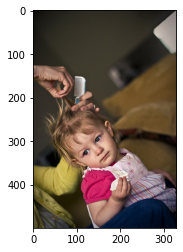

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3464368184.jpg
Real Caption: little girl in pink shirt and pink printed smock dress is getting haircut
Predicted Caption: young girl is holding small red nail polish
BLEU-1 score: 13.381535712974756
BLEU-2 score: 3.9921621141636406e-153
BLEU-3 score: 9.043876231738548e-184
BLEU-4 score: 6.895396983435736e-230


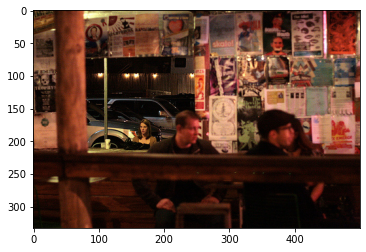

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3370043941.jpg
Real Caption: woman with black purse is sitting in front of wall covered in posters while in the foreground two men are sitting in social setting
Predicted Caption: man is standing in front of an outdoor food
BLEU-1 score: 8.394471237224971
BLEU-2 score: 6.295853427918729
BLEU-3 score: 5.4497138428847585
BLEU-4 score: 8.187981146332927e-77


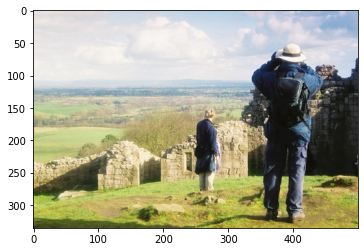

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/429283612.jpg
Real Caption: two people take in the view from hillside
Predicted Caption: two men are standing on beach
BLEU-1 score: 11.942188509563156
BLEU-2 score: 4.3634676769543673e-153
BLEU-3 score: 1.072004124838459e-183
BLEU-4 score: 8.34076112986429e-230


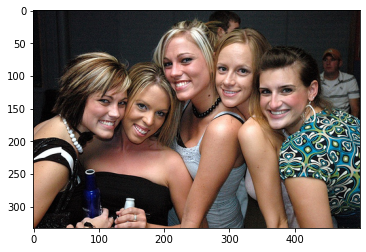

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1510669311.jpg
Real Caption: group of smiling young women posing together
Predicted Caption: three women are posing together
BLEU-1 score: 40.21920276213836
BLEU-2 score: 25.9613837492502
BLEU-3 score: 1.9200516626372871e-91
BLEU-4 score: 6.222676699505816e-153


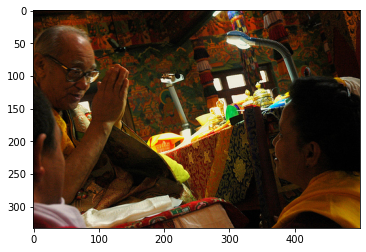

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2448551720.jpg
Real Caption: an elderly man praying in front of two other people
Predicted Caption: man is looking at table with his hand
BLEU-1 score: 9.735009788392563
BLEU-2 score: 4.1072732976237013e-153
BLEU-3 score: 1.0688236188553917e-183
BLEU-4 score: 8.436497969708995e-230


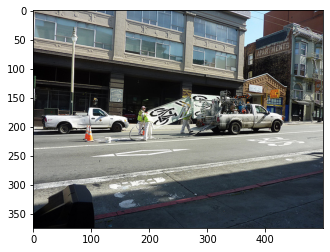

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4722128127.jpg
Real Caption: city crew workers are painting signs on the road
Predicted Caption: man in black shirt and black pants walks down the side of the road
BLEU-1 score: 14.285714285714285
BLEU-2 score: 10.482848367219184
BLEU-3 score: 1.3076481741058403e-91
BLEU-4 score: 4.829607837557234e-153


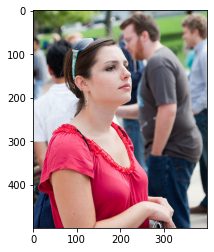

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4963016379.jpg
Real Caption: woman wearing red shirt blue backpack and sunglasses on her head
Predicted Caption: woman in blue shirt is holding camera
BLEU-1 score: 24.202205228903967
BLEU-2 score: 5.51461944293045e-153
BLEU-3 score: 1.1216189750495802e-183
BLEU-4 score: 8.324264127738904e-230


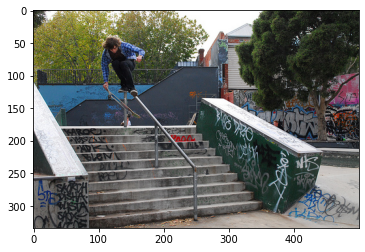

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3412822878.jpg
Real Caption: boy with blue shirt is standing on the railing of flight of stairs
Predicted Caption: skateboarder grinds down rail
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


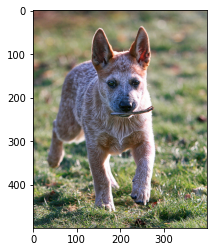

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3116731299.jpg
Real Caption: small dog is carrying stick in his mouth
Predicted Caption: dog with muzzle runs through the grass
BLEU-1 score: 12.383969996431167
BLEU-2 score: 4.887436488566011e-153
BLEU-3 score: 1.2383265317623888e-183
BLEU-4 score: 9.709385502639236e-230


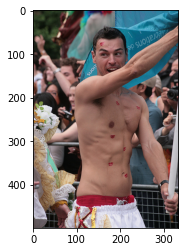

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3685373706.jpg
Real Caption: man is shirtless and is covered in red <unk>
Predicted Caption: man with red shirt and red flag with his head
BLEU-1 score: 30.0
BLEU-2 score: 8.170202920075766e-153
BLEU-3 score: 1.7846088208682726e-183
BLEU-4 score: 1.3483065280626045e-229


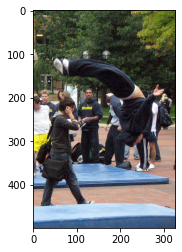

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2924825127.jpg
Real Caption: man <unk> as spectators watch at the university of <unk>
Predicted Caption: man in black shirt and black pants doing back flip on skateboard while crowd of people watch
BLEU-1 score: 17.647058823529413
BLEU-2 score: 6.266259591476803e-153
BLEU-3 score: 1.5219779440726288e-183
BLEU-4 score: 1.1808001696991507e-229


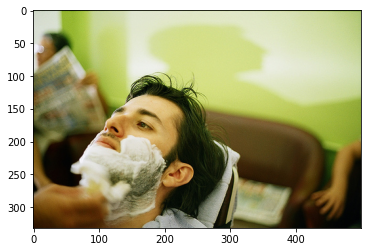

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/244073535.jpg
Real Caption: man is sitting in barber chair getting ready for shave
Predicted Caption: woman with glasses is wearing glasses on his nose
BLEU-1 score: 9.942659075715216
BLEU-2 score: 4.4493443496507245e-153
BLEU-3 score: 1.1854383244313044e-183
BLEU-4 score: 9.412234823955333e-230


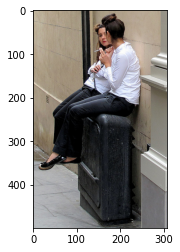

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4775776532.jpg
Real Caption: two women both wearing white shirts and black pants one smoking sitting on fixture on the sidewalk
Predicted Caption: man in black jacket and black jacket is sitting on the phone
BLEU-1 score: 27.468359591685154
BLEU-2 score: 22.222997110566006
BLEU-3 score: 1.7374107073015762e-91
BLEU-4 score: 5.709466295480815e-153


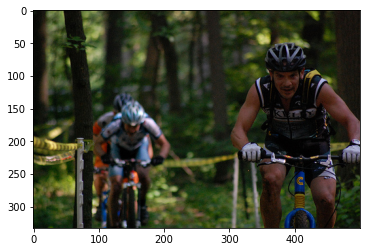

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3584534971.jpg
Real Caption: several bicyclists are riding though wooded area
Predicted Caption: man in helmet and white and white helmet is jumping over log
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


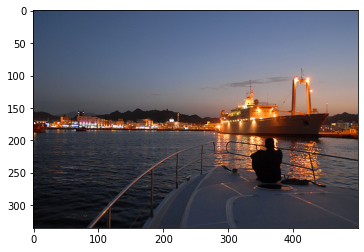

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/238512430.jpg
Real Caption: boat is illuminated at night
Predicted Caption: man fishing off of the water
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


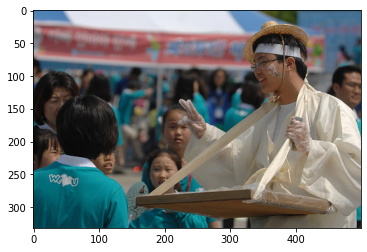

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3497256800.jpg
Real Caption: asian male dressed in white wearing straw hat and gloves gesturing to people in crowd
Predicted Caption: man in blue shirt and black shirt is holding up to another man in the background
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


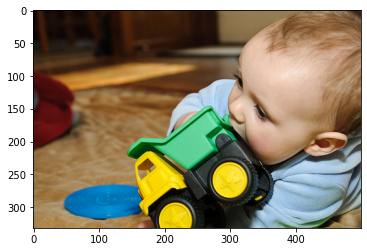

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5234416671.jpg
Real Caption: baby plays with toy dump truck
Predicted Caption: baby is playing with blue eyes and blue eyes and is crying
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


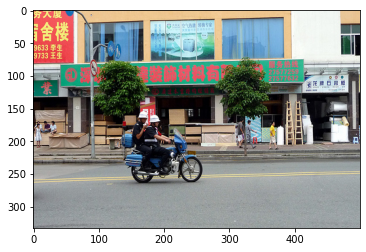

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4762359831.jpg
Real Caption: two men riding blue motorbike down the street
Predicted Caption: man in blue shirt is riding his bike
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


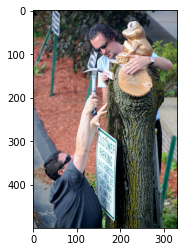

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2549405357.jpg
Real Caption: two men in sunglasses are hammering sign to tree
Predicted Caption: man in black hat is holding up sign
BLEU-1 score: 22.062422564614888
BLEU-2 score: 6.581962593704787e-153
BLEU-3 score: 1.4910831112846667e-183
BLEU-4 score: 1.1368587676511997e-229


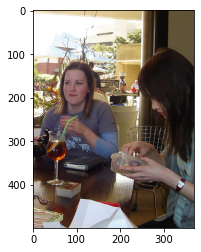

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1154930578.jpg
Real Caption: two women sitting at table with green straw inside of drink
Predicted Caption: two women are sitting at table eating at table eating
BLEU-1 score: 45.241870901797974
BLEU-2 score: 36.939832906091624
BLEU-3 score: 28.326843332059358
BLEU-4 score: 4.1985211987044985e-76


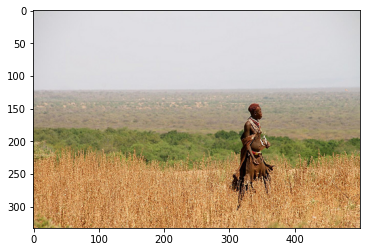

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3203653158.jpg
Real Caption: an african man walks across field
Predicted Caption: man and woman ride through field
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


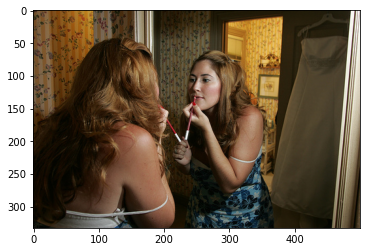

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2074642785.jpg
Real Caption: woman is looking into mirror and applying makeup
Predicted Caption: two women are sitting on the camera
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


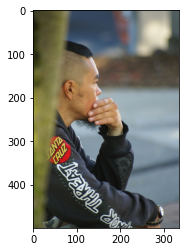

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2856700531.jpg
Real Caption: man with mohawk and beard with his hand on his chin looking off into the distance
Predicted Caption: young man in blue shirt is holding an infant
BLEU-1 score: 5.104731378176962
BLEU-2 score: 2.284369557581617e-153
BLEU-3 score: 6.086243293203436e-184
BLEU-4 score: 4.832402486973384e-230


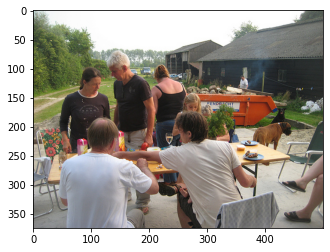

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3969506142.jpg
Real Caption: family sits down to eat at table outside
Predicted Caption: group of people are sitting in front of people
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


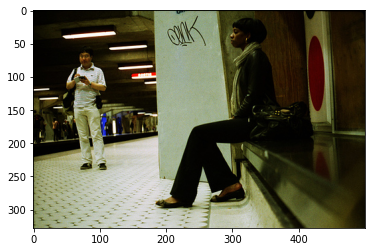

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4618572855.jpg
Real Caption: well dressed young woman waits on bench for the train while man busy writing something waits nearby
Predicted Caption: woman in suit is standing in front of an escalator
BLEU-1 score: 4.965853037914096
BLEU-2 score: 2.342427070484227e-153
BLEU-3 score: 6.373830668275133e-184
BLEU-4 score: 5.087473806581661e-230


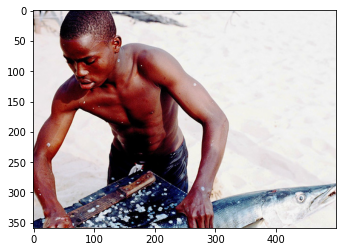

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/400946967.jpg
Real Caption: young muscular african american man cleaning fish shirtless
Predicted Caption: man in blue shirt and white hat is holding large snake wrapped around him
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230


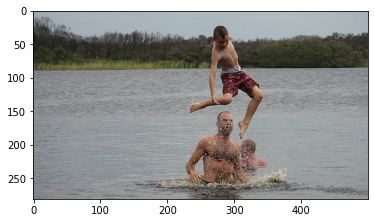

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2202625355.jpg
Real Caption: the boy with the red trunks kicks and grins as he falls back down after being thrown in the air by the man standing in the waist deep water
Predicted Caption: young girl in the water
BLEU-1 score: 0.4937848229412018
BLEU-2 score: 0.31873673264354213
BLEU-3 score: 2.3573126893649672e-93
BLEU-4 score: 7.639791694673699e-155


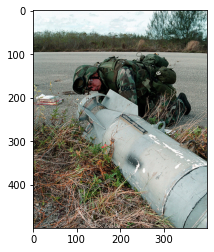

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3051972592.jpg
Real Caption: man serving and protecting
Predicted Caption: man in blue jeans and jeans is sitting on the ground
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


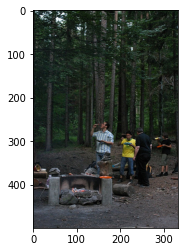

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/226115542.jpg
Real Caption: people are grilling on barbecue in the woods
Predicted Caption: group of people are sitting in park
BLEU-1 score: 37.1519099892935
BLEU-2 score: 23.168286407366764
BLEU-3 score: 1.9875719080152112e-91
BLEU-4 score: 6.68494960953009e-153


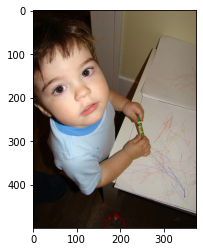

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3275646864.jpg
Real Caption: small child with brown hair and blue shirt is coloring
Predicted Caption: young boy in blue shirt and white shirt and looking at the camera
BLEU-1 score: 23.076923076923077
BLEU-2 score: 13.867504905630728
BLEU-3 score: 1.5466866120248002e-91
BLEU-4 score: 5.554837769749797e-153


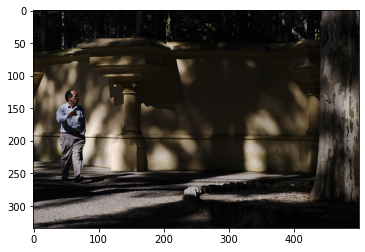

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4584249516.jpg
Real Caption: man in dress pants and blue dress shirt is walking in the shadows of nature
Predicted Caption: man in black shirt and black jacket is walking down the background
BLEU-1 score: 45.43004567916529
BLEU-2 score: 25.363164109286746
BLEU-3 score: 2.010462330660881e-91
BLEU-4 score: 6.629596878450734e-153


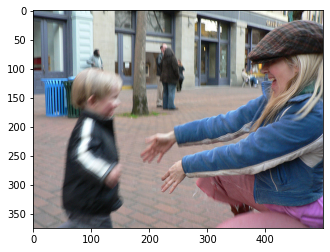

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/124534466.jpg
Real Caption: woman wearing blue jacket reaching out to child
Predicted Caption: woman in blue jacket is holding an adult
BLEU-1 score: 37.5
BLEU-2 score: 23.145502494313785
BLEU-3 score: 2.1032131949153637e-91
BLEU-4 score: 7.176381577237209e-153


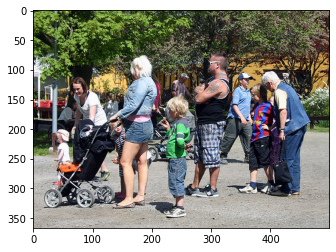

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4629605656.jpg
Real Caption: several adults are tending their children outside on sunny day
Predicted Caption: group of people are walking down the street
BLEU-1 score: 9.735009788392563
BLEU-2 score: 4.1072732976237013e-153
BLEU-3 score: 1.0688236188553917e-183
BLEU-4 score: 8.436497969708995e-230


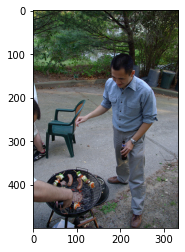

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2494822758.jpg
Real Caption: this asian man is drinking beer and watching guy grill
Predicted Caption: man in blue shirt is sitting on grill
BLEU-1 score: 29.20502936517768
BLEU-2 score: 7.114006032055006e-153
BLEU-3 score: 1.4860807846344539e-183
BLEU-4 score: 1.1103055738259992e-229


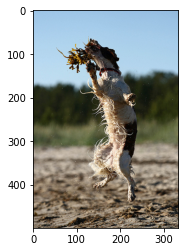

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3650111717.jpg
Real Caption: wet dog catches seaweed in his mouth
Predicted Caption: dog jumping up in the air with stick in the air
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


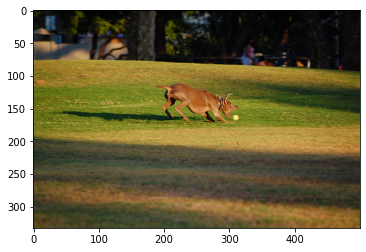

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2629294578.jpg
Real Caption: brown dog chases after yellow ball in park
Predicted Caption: dog runs through field
BLEU-1 score: 9.196986029286059
BLEU-2 score: 2.743770220260171e-153
BLEU-3 score: 6.215759172786402e-184
BLEU-4 score: 4.739132419722992e-230


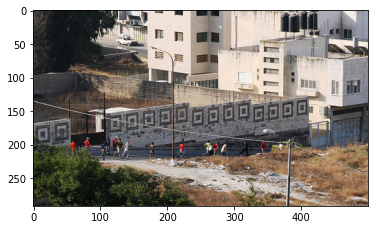

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/526616589.jpg
Real Caption: there are people running down hill in the city
Predicted Caption: people are walking on the side of building
BLEU-1 score: 33.09363384692233
BLEU-2 score: 8.061224930331203e-153
BLEU-3 score: 1.683950142240867e-183
BLEU-4 score: 1.258141043412406e-229


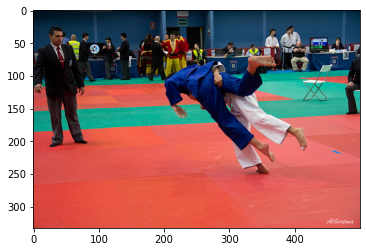

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6796767853.jpg
Real Caption: two martial arts <unk> are fighting in what appears to be tournament
Predicted Caption: two men are practicing form of martial arts competition
BLEU-1 score: 31.845836025501743
BLEU-2 score: 16.888804954640353
BLEU-3 score: 1.523550137109399e-91
BLEU-4 score: 5.189066807518457e-153


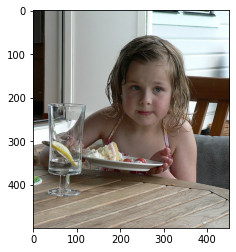

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2123932281.jpg
Real Caption: the little girl is eating outdoors
Predicted Caption: young girl in pink shirt is sitting at table
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


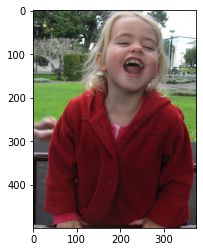

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2844588501.jpg
Real Caption: girl in red jacket laughs at the camera
Predicted Caption: young man with shirt is eating something
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


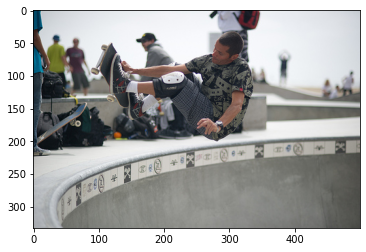

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4542251311.jpg
Real Caption: skateboarder with knee pads gets bit of air time after jumping up out of bowl at skate park
Predicted Caption: man in black shirt and black shirt is pointing while others watch
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


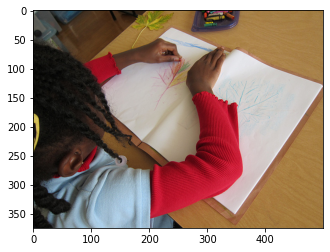

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5200029082.jpg
Real Caption: young girl with blue shirt and red sleeves draws picture with crayons
Predicted Caption: young girl in pink shirt and white and white and white cat
BLEU-1 score: 33.33333333333333
BLEU-2 score: 24.618298195866544
BLEU-3 score: 2.1825195678664249e-91
BLEU-4 score: 7.401184483348608e-153


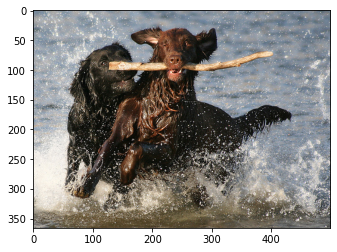

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/257588281.jpg
Real Caption: black dog chases brown dog with stick through the water
Predicted Caption: dog swims in the water with stick in the water
BLEU-1 score: 50.0
BLEU-2 score: 33.33333333333333
BLEU-3 score: 2.617764516460675e-91
BLEU-4 score: 8.612150057732662e-153


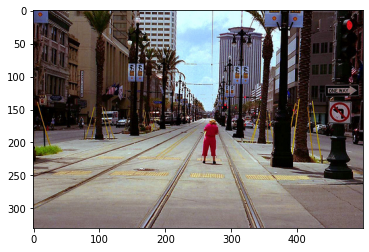

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/206475531.jpg
Real Caption: confused person standing in the middle of the trolley tracks trying to figure out the signs
Predicted Caption: man in suit is parked on the street
BLEU-1 score: 9.196986029286059
BLEU-2 score: 2.743770220260171e-153
BLEU-3 score: 6.215759172786402e-184
BLEU-4 score: 4.739132419722992e-230


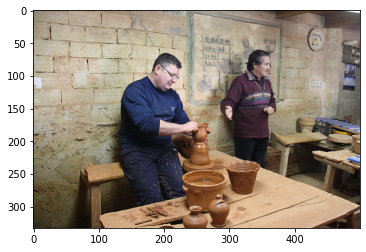

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6521767045.jpg
Real Caption: two men one dressed in blue shirt and pants and one dressed in purple shirt and black pants are creating pottery
Predicted Caption: two men are sitting at table with
BLEU-1 score: 5.8000835672834015
BLEU-2 score: 3.616987587238681
BLEU-3 score: 3.102958412042699e-92
BLEU-4 score: 1.043641266075602e-153


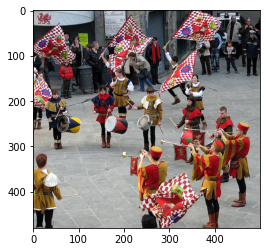

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/428501119.jpg
Real Caption: small band dressed as <unk> performs in the street
Predicted Caption: group of people are walking down the street
BLEU-1 score: 22.062422564614888
BLEU-2 score: 16.677623835883093
BLEU-3 score: 1.6434977345885395e-91
BLEU-4 score: 5.722633035689358e-153


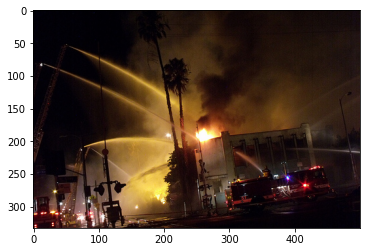

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4797878234.jpg
Real Caption: nighttime scene where firefighters <unk> attempt to put out building fire shooting water from all directions
Predicted Caption: man is standing around fire
BLEU-1 score: 2.2160631672466775
BLEU-2 score: 7.391615259241302e-154
BLEU-3 score: 1.750926022688483e-184
BLEU-4 score: 1.3499508674573844e-230


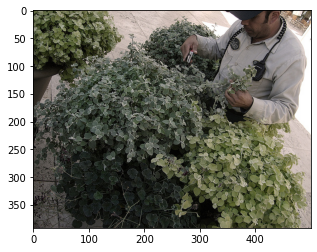

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/273602422.jpg
Real Caption: man wearing hat trimming plant
Predicted Caption: man in blue shirt and white shirt is sitting on rock
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


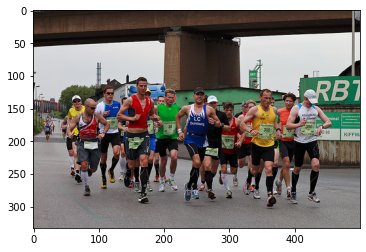

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7232703918.jpg
Real Caption: people running in marathon in running clothes
Predicted Caption: group of people are running race
BLEU-1 score: 28.2160574963538
BLEU-2 score: 7.290027635886345e-153
BLEU-3 score: 1.5591498913318324e-183
BLEU-4 score: 1.171778691554733e-229


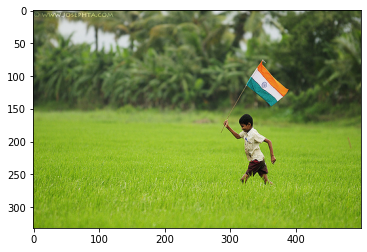

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4922043349.jpg
Real Caption: young boy in tan shirt and brown shorts holding flag while moving
Predicted Caption: young girl is walking through field
BLEU-1 score: 6.1313240195240395
BLEU-2 score: 2.2402790036937483e-153
BLEU-3 score: 5.503852693656168e-184
BLEU-4 score: 4.282289549833951e-230


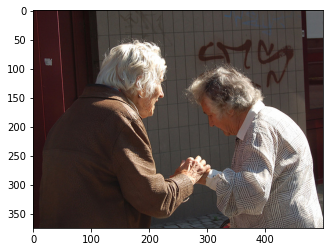

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2103104748.jpg
Real Caption: two elderly ladies one wearing brown blouse and the other gray are holding hands outside
Predicted Caption: man in white shirt is holding up in the other people
BLEU-1 score: 18.958470774514876
BLEU-2 score: 11.479924150721384
BLEU-3 score: 1.1939788508927353e-91
BLEU-4 score: 4.213850193469532e-153


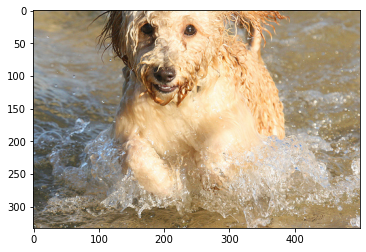

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3150380412.jpg
Real Caption: wet dog is splashing through shallow water
Predicted Caption: brown dog swims through the water
BLEU-1 score: 42.324086244530704
BLEU-2 score: 8.92842395935524e-153
BLEU-3 score: 1.7608211516934517e-183
BLEU-4 score: 1.2967862918337585e-229


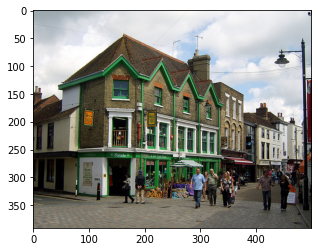

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3628564816.jpg
Real Caption: lots of people are walking
Predicted Caption: people walking down street with people walking down street
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


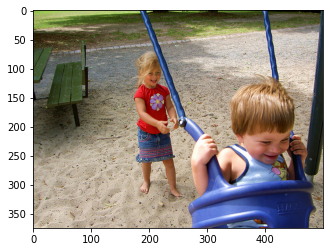

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2312746782.jpg
Real Caption: little girl pushes little boy on the swing
Predicted Caption: two young boys playing on swing
BLEU-1 score: 23.88437701912631
BLEU-2 score: 6.17087516772532e-153
BLEU-3 score: 1.319791889377583e-183
BLEU-4 score: 9.918892480173173e-230


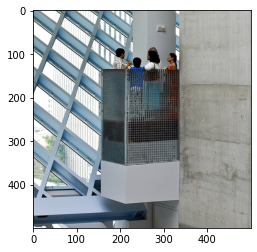

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/970641406.jpg
Real Caption: four people ride in an outdoor elevator
Predicted Caption: man in blue shirt and blue shirt and blue sky
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


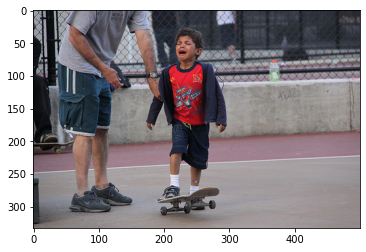

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3516677529.jpg
Real Caption: child is riding skateboard and crying while man holds his arm
Predicted Caption: two young boys wearing red shirt is holding basketball
BLEU-1 score: 8.897082254631197
BLEU-2 score: 3.981448258113331e-153
BLEU-3 score: 1.0607768203596798e-183
BLEU-4 score: 8.42243777956461e-230


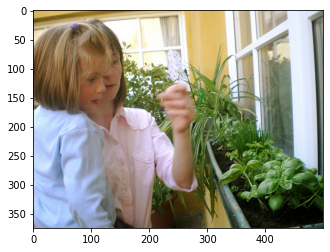

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3429115635.jpg
Real Caption: woman and child look at window box filled with herbs
Predicted Caption: two children are sitting on the grass next to be
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


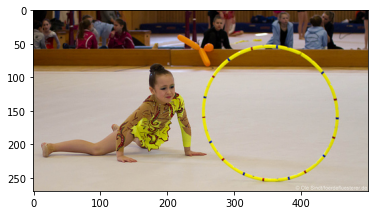

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5566135246.jpg
Real Caption: young <unk> gymnastic is watching yellow hula hoop go by during her routine
Predicted Caption: woman in pink hair and black and black and black and black and black
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


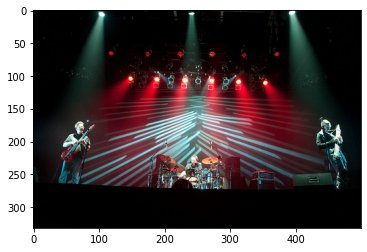

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7391692544.jpg
Real Caption: rock band on stage <unk> in light show
Predicted Caption: band is standing on stage with their hands up in the air
BLEU-1 score: 33.33333333333333
BLEU-2 score: 17.407765595569778
BLEU-3 score: 1.7727567490939188e-91
BLEU-4 score: 6.223629500679345e-153


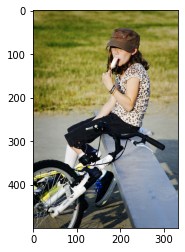

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3621741935.jpg
Real Caption: girl is sitting on bench eating ice cream with bike next to her
Predicted Caption: woman wearing blue shirt is riding bike
BLEU-1 score: 12.124938447912854
BLEU-2 score: 3.3836527003416395e-153
BLEU-3 score: 7.463350408713334e-184
BLEU-4 score: 5.652478243478208e-230


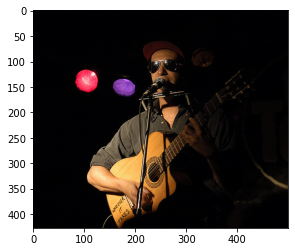

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3312455265.jpg
Real Caption: musician playing guitar and harmonica singing song with <unk> it takes written on his guitar
Predicted Caption: man in black shirt sings into microphone
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


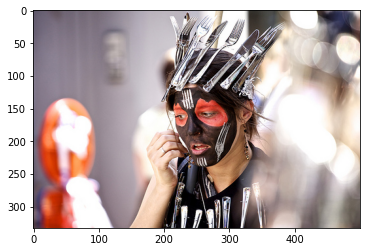

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4631476946.jpg
Real Caption: the young lady is decorating herself for halloween
Predicted Caption: woman with long hair and white and black bows
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


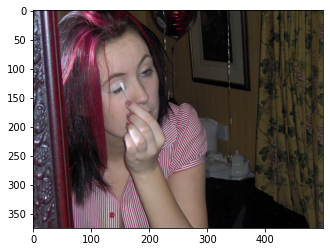

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/133031387.jpg
Real Caption: young woman with red <unk> in her hair is applying <unk> with in front of mirror
Predicted Caption: woman is looking through her eyes in her eyes
BLEU-1 score: 20.41892551270785
BLEU-2 score: 10.828770520934043
BLEU-3 score: 9.76870468704315e-92
BLEU-4 score: 3.327127871233669e-153


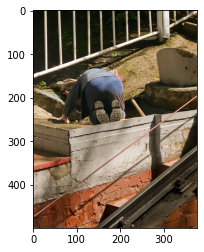

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/863901193.jpg
Real Caption: maintenance worker on hands and knees cleaning out <unk> ditch
Predicted Caption: man in blue shirt and hat is working on the ground
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


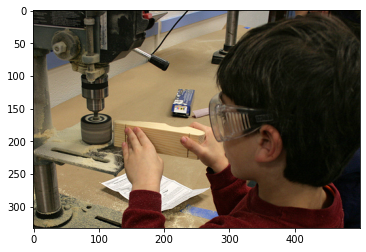

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4297523137.jpg
Real Caption: child <unk> the side of block using power tool
Predicted Caption: man in blue shirt is looking through microscope
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


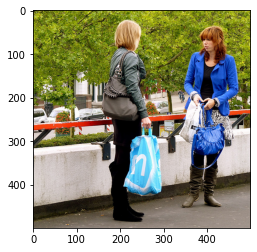

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4923692902.jpg
Real Caption: two women with shopping bags talk to each other next to red railing
Predicted Caption: two women in the street
BLEU-1 score: 8.075860719786215
BLEU-2 score: 6.38452848520282
BLEU-3 score: 5.12073331234396e-92
BLEU-4 score: 1.693561782413098e-153


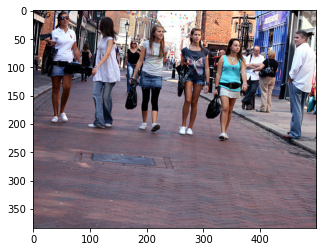

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2881685775.jpg
Real Caption: group of girls is walking down the street
Predicted Caption: group of people are walking down the street
BLEU-1 score: 75.0
BLEU-2 score: 65.46536707079771
BLEU-3 score: 55.778982530324605
BLEU-4 score: 41.11336169005197


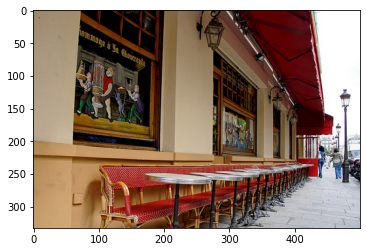

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4863558500.jpg
Real Caption: long red bench accompanied by little circular tables
Predicted Caption: man in suit is sitting on the street
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


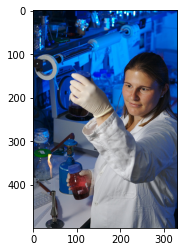

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3951142610.jpg
Real Caption: woman in lab coat working
Predicted Caption: man in red shirt is holding up her hand
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


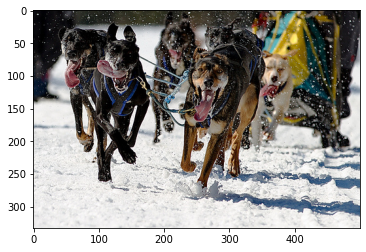

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6804390530.jpg
Real Caption: dog team is pulling sled through the snow and the <unk> is <unk> by each dog tongue extended from their mouth
Predicted Caption: team of dogs sled team in the snow
BLEU-1 score: 9.845583760209703
BLEU-2 score: 5.262685886212884
BLEU-3 score: 4.514777849439453e-92
BLEU-4 score: 1.5184890820812707e-153


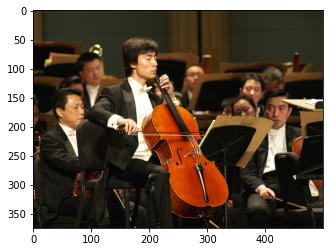

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3321832766.jpg
Real Caption: an orchestra in formal dress with man playing the cello in the center
Predicted Caption: group of people playing instruments
BLEU-1 score: 4.037930359893108
BLEU-2 score: 1.3468401129116942e-153
BLEU-3 score: 3.1903952240336635e-184
BLEU-4 score: 2.459770855197576e-230


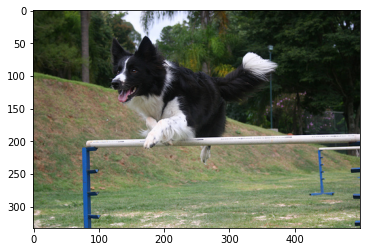

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/458213442.jpg
Real Caption: dog jumps over hurdle on grass field
Predicted Caption: dog jumps over an obstacle
BLEU-1 score: 40.21920276213836
BLEU-2 score: 36.71494099616211
BLEU-3 score: 33.59558495175079
BLEU-4 score: 4.6038197862150135e-76


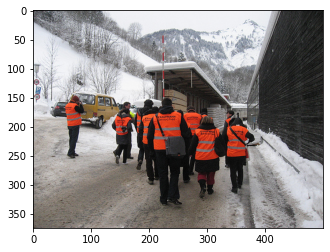

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4344503313.jpg
Real Caption: several men and woman dressed in orange vests walking down road in winter
Predicted Caption: group of people are walking through the street
BLEU-1 score: 6.69076785648738
BLEU-2 score: 2.822884902521212e-153
BLEU-3 score: 7.345910141578792e-184
BLEU-4 score: 5.798314605122797e-230


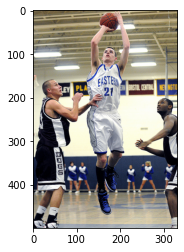

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3182558164.jpg
Real Caption: basketball player in the air about to make shot
Predicted Caption: two men are playing game
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


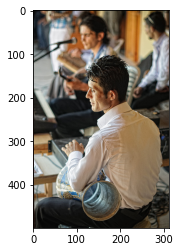

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7863808892.jpg
Real Caption: man is playing hand drum on his last with other people in band
Predicted Caption: man in blue shirt and white shirt is sitting on the air
BLEU-1 score: 30.668147154310777
BLEU-2 score: 7.923560558566541e-153
BLEU-3 score: 1.6946463306991526e-183
BLEU-4 score: 1.2736110049935266e-229


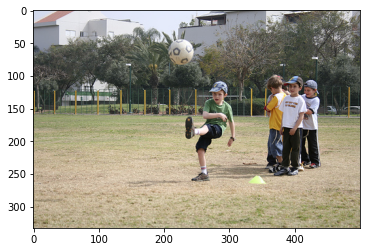

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/171822522.jpg
Real Caption: boy is kicking ball as other children watch him
Predicted Caption: two men in blue uniforms are running in field
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


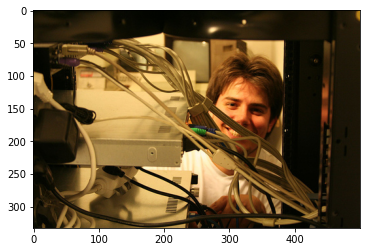

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/127149546.jpg
Real Caption: man looking at the back of computer wires inspecting the job he has done
Predicted Caption: woman is playing the black shirt is playing the camera
BLEU-1 score: 13.406400920712787
BLEU-2 score: 4.471666651098519e-153
BLEU-3 score: 1.0592485173532028e-183
BLEU-4 score: 8.166726842395623e-230


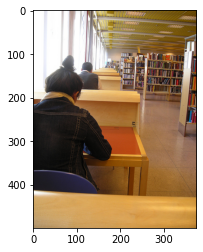

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3367053761.jpg
Real Caption: group of people from behind seated in line of desks by windows in library
Predicted Caption: man in suit is sitting in front of an office
BLEU-1 score: 20.10960138106918
BLEU-2 score: 5.476650797505702e-153
BLEU-3 score: 1.1962590669600284e-183
BLEU-4 score: 9.03796893961078e-230


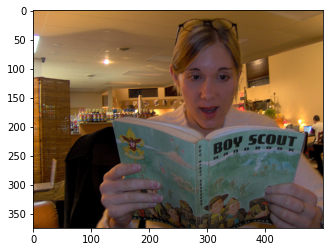

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/335824468.jpg
Real Caption: caucasian woman reading boy scout <unk>
Predicted Caption: woman is looking at the camera as she is holding her hand
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


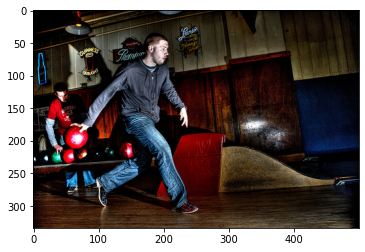

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3457784061.jpg
Real Caption: man bowls with red bowling ball
Predicted Caption: man in black shirt and black shirt is walking in front of an advertisement
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230


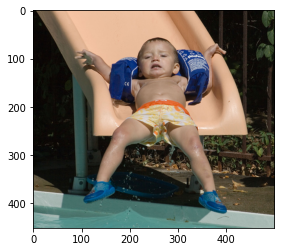

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1303335399.jpg
Real Caption: little boy has gown down an orange slide
Predicted Caption: young girl in blue goggles and goggles
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


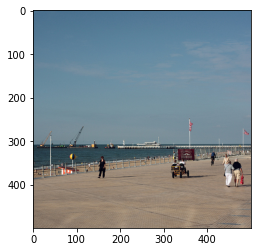

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4951841137.jpg
Real Caption: there are few people strolling along large <unk> walkway
Predicted Caption: people relax on the beach
BLEU-1 score: 8.986579282344431
BLEU-2 score: 2.997447795420392e-153
BLEU-3 score: 7.100355149153815e-184
BLEU-4 score: 5.474320712955125e-230


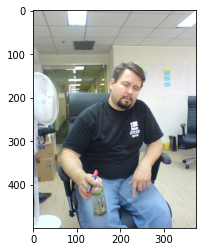

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1301978702.jpg
Real Caption: man in black shirt sits while closing his eyes
Predicted Caption: man in blue shirt is sitting in front of the background
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153


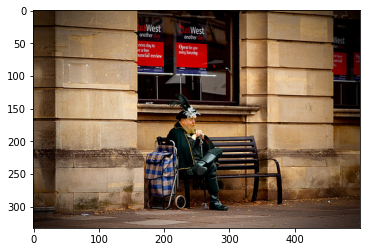

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4735943244.jpg
Real Caption: man in interesting clothes consisting of feathered hat cape and an <unk> cane sits on bench outside building
Predicted Caption: man in blue shirt is sitting on bench next to an abandoned building
BLEU-1 score: 31.417495307233175
BLEU-2 score: 18.87956504614641
BLEU-3 score: 1.5958202971430255e-91
BLEU-4 score: 5.347490705998843e-153


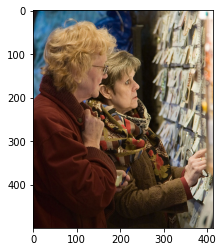

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3135424930.jpg
Real Caption: two woman are looking on different types of papers and photos on wall
Predicted Caption: woman in black shirt is holding baby in her hand
BLEU-1 score: 7.40818220681718
BLEU-2 score: 3.4944905561718586e-153
BLEU-3 score: 9.508638009516205e-184
BLEU-4 score: 7.58961907326157e-230


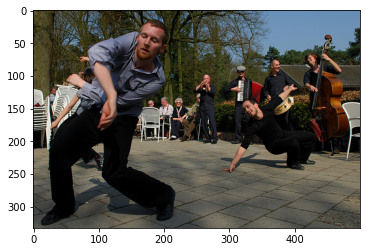

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3416852229.jpg
Real Caption: two young men one in blue shirt and one in black shirt are dancing in front of band and several elderly adults
Predicted Caption: man in black shirt and black shirt and one of people
BLEU-1 score: 26.75486844883217
BLEU-2 score: 19.841941491267264
BLEU-3 score: 16.175918566650722
BLEU-4 score: 2.2655717504324358e-76


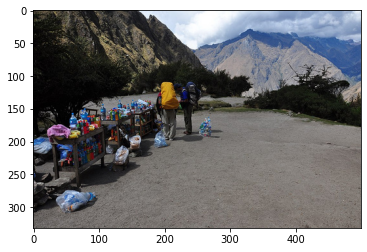

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3827227200.jpg
Real Caption: two people with hiking gear at <unk> on mountain
Predicted Caption: group of people are sitting on the beach
BLEU-1 score: 22.062422564614888
BLEU-2 score: 6.581962593704787e-153
BLEU-3 score: 1.4910831112846667e-183
BLEU-4 score: 1.1368587676511997e-229
BLEU-1 count: 125
BLEU-2 count: 58
BLEU-3 count: 16
BLEU-4 count: 5
BLEU-1 Total: 31.23496242157929
BLEU-2 Total: 12.890704133501695
BLEU-3 Total: 4.3667958177618225
BLEU-4 Total: 1.334150351659401
BLEU-1 Average: 0.24987969937263432
BLEU-2 Average: 0.22225351954313266
BLEU-3 Average: 0.2729247386101139
BLEU-4 Average: 0.2668300703318802


'\nprint(f"BLEU-1 count: {blue_count_1}", f"BLEU-1 Average: {blue_1/blue_count_1}")\nprint(f"BLEU-1 count: {blue_count_2}",f"BLEU-1 Average: {blue_2/blue_count_2}")\nprint(f"BLEU-1 count: {blue_count_3}",f"BLEU-1 Average: {blue_3/blue_count_3}")\nprint(f"BLEU-1 count: {blue_count_4}",f"BLEU-1 Average: {blue_4/blue_count_4}")\n'

In [95]:
blue_1 = 0
blue_2 = 0
blue_3 = 0
blue_4 = 0
blue_count_1 = 0
blue_count_2 = 0
blue_count_3 = 0
blue_count_4 = 0
for j in range(200):
    start_token = tokenizer.word_index['<start>']
    end_token = tokenizer.word_index['<end>']
    # select random image from validation data
    rid = np.random.randint(0, len(img_name_val))
    image = img_name_val[rid]
    split_image  = image.split("/")
    image = PATH1+split_image[3]
    temp_image = np.array(Image.open(image))
    plt.imshow(temp_image)
    plt.show()
    real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
    caption,result,attention_weights = evaluate(image)
    first = real_caption.split(' ', 1)[1]
    real_caption = first.rsplit(' ', 1)[0]

    #remove "<unk>" in result
    for i in caption:
        if i=="<unk>":
            caption.remove(i)

    for i in real_caption:
        if i=="<unk>":
            real_caption.remove(i)

    #remove <end> from result         
    result_join = ' '.join(caption)
    result_final = result_join.rsplit(' ', 1)[0]

    real_appn = []
    real_appn.append(real_caption.split())
    reference = real_appn
    candidate = caption
    print("image",image)
    print ('Real Caption:', real_caption)
    print ('Predicted Caption:', ' '.join(caption))
    score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
    if score > 0.1:
        blue_1 +=score
        blue_count_1 +=1
    print(f"BLEU-1 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
    if score > 0.1:
        blue_2 +=score
        blue_count_2 +=1
    print(f"BLEU-2 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
    if score > 0.1:
        blue_3 +=score
        blue_count_3 += 1
    print(f"BLEU-3 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
    if score > 0.1:
        blue_4 +=score
        blue_count_4 += 1
    print(f"BLEU-4 score: {score*100}")

print(f"BLEU-1 count: {blue_count_1}")
print(f"BLEU-2 count: {blue_count_2}")
print(f"BLEU-3 count: {blue_count_3}")
print(f"BLEU-4 count: {blue_count_4}")
print(f"BLEU-1 Total: {blue_1}")
print(f"BLEU-2 Total: {blue_2}")
print(f"BLEU-3 Total: {blue_3}")
print(f"BLEU-4 Total: {blue_4}")
if blue_count_1 > 0:
    print(f"BLEU-1 Average: {blue_1/blue_count_1}")
if blue_count_2 > 0:
    print(f"BLEU-2 Average: {blue_2/blue_count_2}")
if blue_count_3 > 0:
    print(f"BLEU-3 Average: {blue_3/blue_count_3}")
if blue_count_4 > 0:
    print(f"BLEU-4 Average: {blue_4/blue_count_4}")
"""
print(f"BLEU-1 count: {blue_count_1}", f"BLEU-1 Average: {blue_1/blue_count_1}")
print(f"BLEU-1 count: {blue_count_2}",f"BLEU-1 Average: {blue_2/blue_count_2}")
print(f"BLEU-1 count: {blue_count_3}",f"BLEU-1 Average: {blue_3/blue_count_3}")
print(f"BLEU-1 count: {blue_count_4}",f"BLEU-1 Average: {blue_4/blue_count_4}")
"""